(chap3)=

# 4. Extending Linear Models

A common trope in a sales pitch is the phrase "But wait! There is
more!\" In the lead up an audience is shown a product that incredibly
seems to do it all, but somehow the salesperson shows off another use
case for the already incredibly versatile tool. This is what we say to
you about linear regression. In Chapter [3](chap2) we show a
variety of ways to use and extend linear regression. But there is still
a lot more we can do with linear models. From covariate transformation,
varying variance, to multilevel models: each of these ideas provide
extra flexibility to use linear regressions in an even wider set of
circumstances.

(transforming_covariates)=

## 4.1 Transforming Covariates

In Chapter [3](chap2) we saw that with a linear model and an
identity link function, a unit change in $x_i$ led to a $\beta_i$ change
in the expected response variable $Y$, at any value of $X_i$. Then we
saw how Generalized Linear Models can be created by changing the
likelihood function (e.g. from a Gaussian to Bernoulli), which in
general requires a change in the link function.

Another useful modification, to the vanilla linear model, is to
transform the covariates $\mathbf{X}$, in order to make the relationship
between $\mathbf{X}$ and $Y$ nonlinear. For example, we may assume that
a square-root-unit change or log-unit change, etc. in $x_i$ led to a
$\beta_i$ change in the expected response variable $Y$. We can note
express mathematically by extending Equation
[eq:expanded_regression](eq:expanded_regression) with an additional
term, $f(.)$, which indicates an arbitrary transformation applied to
each covariate $(X_i)$:

```{math} 
:label: eq:covariate_transformation_regression

\begin{split}
    \mu =& \beta_0 + \beta_1 f_1(X_1) + \dots + \beta_m f_m(X_m) \\
Y \sim& \mathcal{N}(\mu, \sigma)
\end{split}
```

In most of our previous examples $f(.)$ was present but was the identity
transformation. In a couple of the previous examples we centered the
covariates to make the coefficient easier to interpret and the centering
operation is one type of covariate transformation. However, $f(.)$ can
be any arbitrary transformation. To illustrate, let us borrow an example
from Bayesian Analysis with Python {cite:p}`martin_2018` and create a model for
the length of babies. First we will load the data and plot in Code Block
[babies_data](babies_data) and plot the age and month in
{numref}`fig:Baby_Length_Scatter`.

```{code-block} python
:name: babies_data
:caption: babies_data

babies = pd.read_csv("../data/babies.csv")
# Add a constant term so we can use the dot product to express the intercept
babies["Intercept"] = 1
```

```{figure} figures/Baby_Length_Scatter.png
:name: fig:Baby_Length_Scatter
:width: 7.00in
Scatter plot of the nonlinear correlation between a baby's age in months
and observed, or measured, length.
```

In [1]:
import pymc as pm
import matplotlib.pyplot as plt
import arviz as az
import xarray as xr
import pandas as pd
import numpy as np
from scipy import stats

In [2]:
az.style.use("arviz-grayscale")
plt.rcParams['figure.dpi'] = 300 

In [3]:
babies = pd.read_csv('../data/babies.csv')

# Add a constant term so we can use a the dot product approach
babies["Intercept"] = 1

babies.head()

,Month,Length,Intercept
0,0,48.5,1
1,0,50.5,1
2,0,50.5,1
3,0,52.0,1
4,0,47.5,1


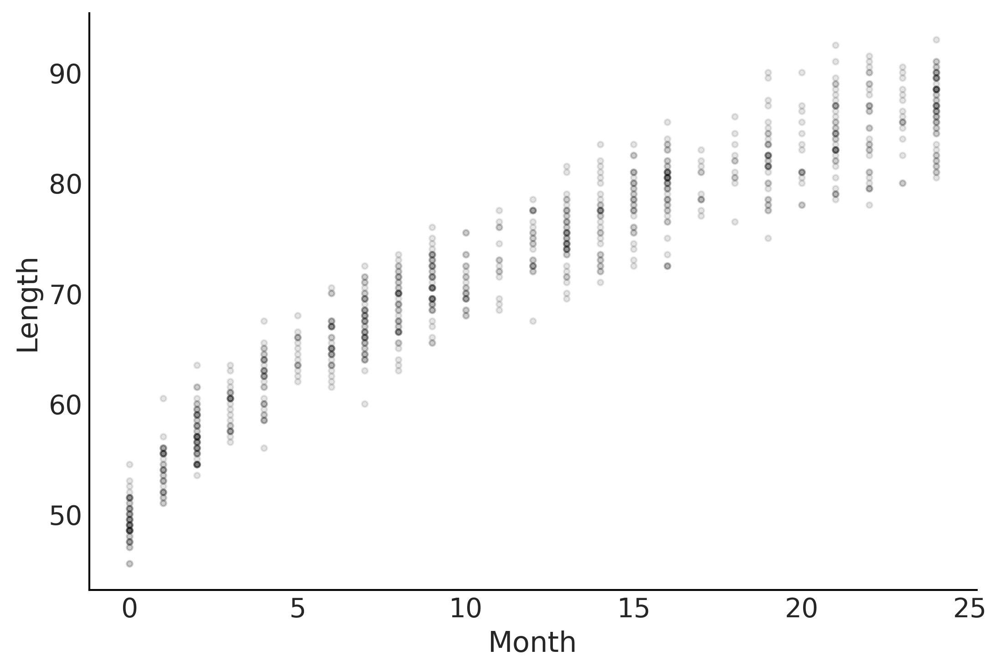

In [4]:
fig, ax = plt.subplots()

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)
ax.set_ylabel("Length")
ax.set_xlabel("Month");
plt.savefig('img/chp04/baby_length_scatter.png', dpi=300)

Let us formulate a model in Code Block
[babies_linear](babies_linear) which we can use to predict
the length of the baby at each month of their childhood, as well as
determine how quickly a child is growing per month. Note that this model
formulation contains no transformations, and nothing we have not seen
already in Chapter [3](chap2).

```{code-block} python
:name: babies_linear
:caption: babies_linear

with pm.Model() as model_baby_linear:
    β = pm.Normal("β", sigma=10, shape=2)

    μ = pm.Deterministic("μ", pm.math.dot(babies[["Intercept", "Month"]], β))
    ϵ = pm.HalfNormal("ϵ", sigma=10)

    length = pm.Normal("length", mu=μ, sigma=ϵ, observed=babies["Length"])

    trace_linear = pm.sample(draws=2000, tune=4000)
    pcc_linear = pm.sample_posterior_predictive(trace_linear)
    inf_data_linear = az.from_pymc3(trace=trace_linear,
                                    posterior_predictive=pcc_linear)
```

In [5]:
with pm.Model() as model_baby_linear:
    β = pm.Normal('β', sigma=10, shape=2)
    
    # Use dot product instead of expanded multiplication
    μ = pm.Deterministic("μ", pm.math.dot(babies[["Intercept", "Month"]], β))
    ϵ = pm.HalfNormal("ϵ", sigma=10)

    length = pm.Normal("length", mu=μ, sigma=ϵ, observed=babies["Length"])

    idata_linear = pm.sample(draws=2000, tune=4000, idata_kwargs={"log_likelihood": True})
    idata_linear.extend(pm.sample_posterior_predictive(idata_linear))

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, ϵ]


Output()

Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 3 seconds.
Sampling: [length]


Output()

`model_linear` faithfully gives us a linear growth rate as shown
{numref}`fig:Baby_Length_Linear`, estimating that babies will grow at
the same rate of around 1.4 cm in each month of their observed
childhood. However, it likely does not come as a surprise to you that
humans do not grow at the same rate their entire lives and that they
tend to grow more rapidly in the earlier stages of life. In other words
the relationship between age and length is nonlinear. Looking more
closely at {numref}`fig:Baby_Length_Linear` we can see some issues with
the linear trend and the underlying data. The model tends to
overestimate the length of babies close to 0 months of age, and over
estimate length at 10 months of age, and then once again underestimate
at 25 months of age. We asked for a straight line and we got a straight
line even if the fit is not all that great.

```{figure} figures/Baby_Length_Linear_Fit.png
:name: fig:Baby_Length_Linear
:width: 7.00in
A linear prediction of baby length, where the mean is the blue line, the
dark gray is the 50% highest density interval of the posterior
predictive and the light gray is the 94% highest density interval of the
posterior predictive. The highest density interval around the mean line
of fit covers most of the data points despite the predictions tend to be
either biased high in the early months, 0 to 3, as well as late months,
22 to 25, and biased low in the middle at months 10 to 15.
```

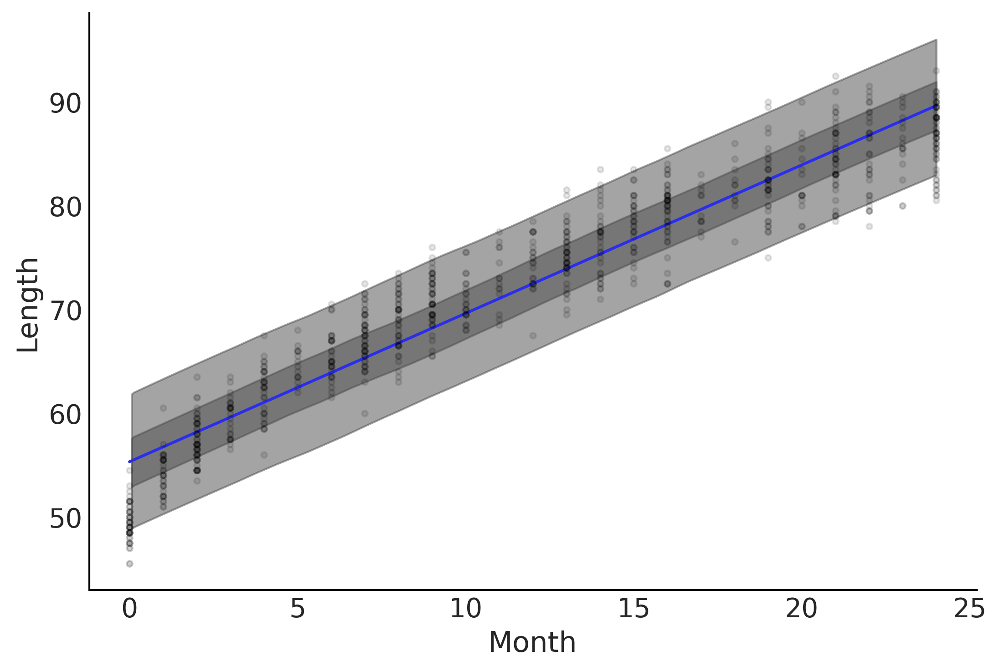

In [6]:
fig, ax = plt.subplots()

ax.set_ylabel("Length")
ax.set_xlabel("Month");

μ_m = idata_linear.posterior["μ"].mean(("chain", "draw"))

ax.plot(babies["Month"], μ_m, c='C4')
az.plot_hdi(babies["Month"], idata_linear.posterior_predictive["length"], hdi_prob=.50, ax=ax)
az.plot_hdi(babies["Month"], idata_linear.posterior_predictive["length"], hdi_prob=.94, ax=ax)

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

plt.savefig('img/chp04/baby_length_linear_fit.png', dpi=300)

In [7]:
az.loo(idata_linear)

Computed from 8000 posterior samples and 800 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -2133.30    18.60
p_loo        3.21        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)      800  100.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%

Thinking back to our model choices, we still believe that at any age, or
vertical slice of the observed data, the distribution of baby lengths
being Gaussian-like, but the relationship between the month and mean
length is nonlinear. Specifically, we decide that the nonlinearity
generally follows the shape of a square root transformation on the month
covariate which we write in `model_sqrt` in Code Block
[babies_transformed](babies_transformed).

```{code-block} python
:name: babies_transformed
:caption: babies_transformed

with pm.Model() as model_baby_sqrt:
    β = pm.Normal("β", sigma=10, shape=2)

    μ = pm.Deterministic("μ", β[0] + β[1] * np.sqrt(babies["Month"]))
    σ = pm.HalfNormal("σ", sigma=10)

    length = pm.Normal("length", mu=μ, sigma=σ, observed=babies["Length"])
    inf_data_sqrt = pm.sample(draws=2000, tune=4000)
```

```{figure} figures/Baby_Length_Sqrt_Fit.png
:name: fig:Baby_Length_non_linear
:width: 7.00in
Linear prediction with transformed covariate. On the left the x-axes is
untransformed and on the right transformed. The linearization of the
nonlinear growth rate is visible on the transformed axes on the right.
```

Plotting the fit of the means, along with bands representing the highest
density interval of the expected length, yields
{numref}`fig:Baby_Length_non_linear`, in which the means tends to fit
the curve of the observed relationship. In addition to this visual check
we can also use `az.compare` to verify the ELPD value for the nonlinear
model. In your own analysis you can use any transformation function you
would like. As with any model the important bit is to be able to justify
your choice whatever it may be, and verify your results are reasonable
using visual and numerical checks.

In [8]:
with pm.Model() as model_baby_sqrt:
    β = pm.Normal("β", sigma=10, shape=2)

    μ = pm.Deterministic("μ", β[0] + β[1] * np.sqrt(babies["Month"]))
    σ = pm.HalfNormal("σ", sigma=10)

    length = pm.Normal("length", mu=μ, sigma=σ, observed=babies["Length"])
    idata_sqrt = pm.sample(draws=2000, tune=4000, idata_kwargs={"log_likelihood": True})
    idata_sqrt.extend(pm.sample_posterior_predictive(idata_sqrt))


Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]


Output()

Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 4 seconds.
Sampling: [length]


Output()

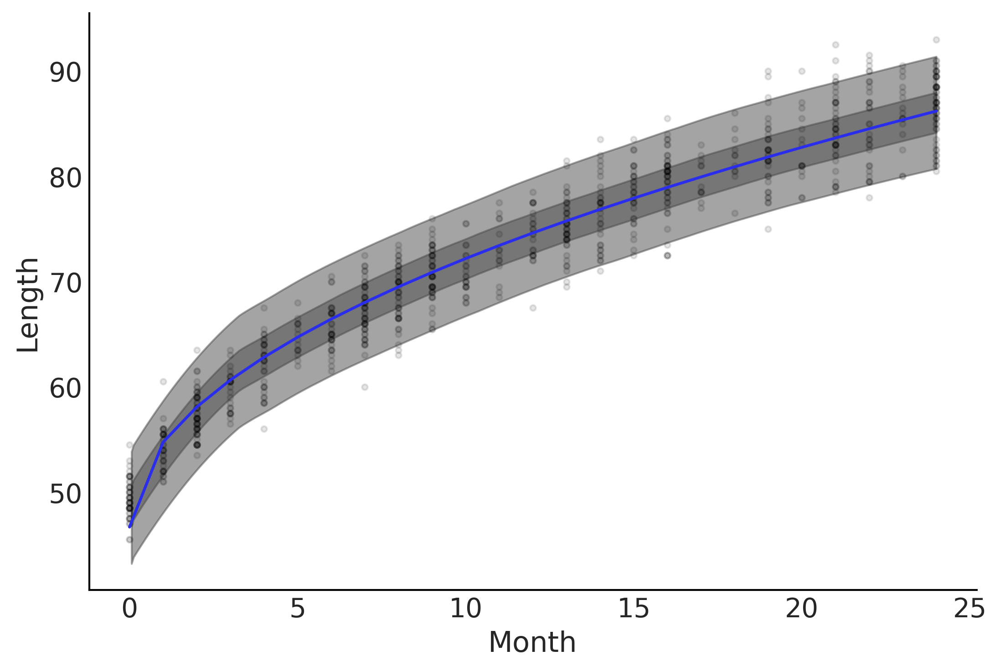

In [9]:
fig, ax = plt.subplots()

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

ax.set_ylabel("Length")
ax.set_xlabel("Month");

μ_m = idata_sqrt.posterior["μ"].mean(("chain", "draw"))

az.plot_hdi(babies["Month"], idata_sqrt.posterior_predictive["length"], hdi_prob=.50, ax=ax)
az.plot_hdi(babies["Month"], idata_sqrt.posterior_predictive["length"], hdi_prob=.94, ax=ax)

ax.plot(babies["Month"], μ_m, c='C4')

plt.savefig('img/chp04/baby_length_sqrt_fit.png', dpi=300)

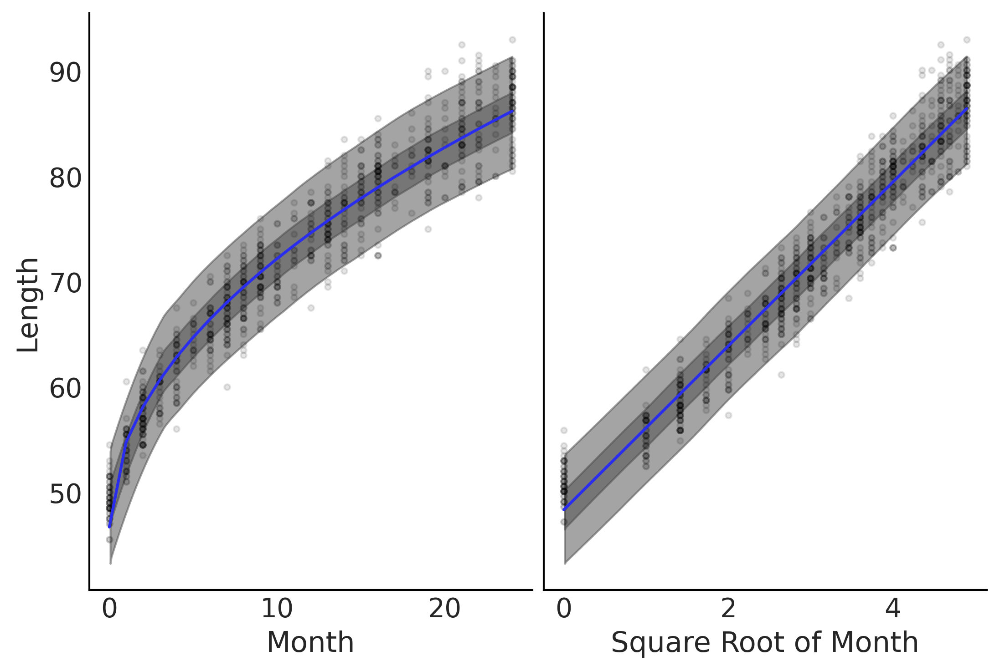

In [10]:
fig, axes = plt.subplots(1,2)
axes[0].plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

μ_m = idata_sqrt.posterior["μ"].mean(("chain", "draw"))

axes[0].plot(babies["Month"], μ_m, c='C4')
az.plot_hdi(babies["Month"], idata_sqrt.posterior_predictive["length"], hdi_prob=.50, ax=axes[0])
az.plot_hdi(babies["Month"], idata_sqrt.posterior_predictive["length"], hdi_prob=.94, ax=axes[0])

axes[0].set_ylabel("Length")
axes[0].set_xlabel("Month");

axes[1].plot(np.sqrt(babies["Month"]), babies["Length"], 'C0.', alpha=0.1)
axes[1].set_xlabel("Square Root of Month");

az.plot_hdi(np.sqrt(babies["Month"]), idata_sqrt.posterior_predictive["length"], hdi_prob=.50, ax=axes[1])
az.plot_hdi(np.sqrt(babies["Month"]), idata_sqrt.posterior_predictive["length"], hdi_prob=.94, ax=axes[1])
axes[1].plot(np.sqrt(babies["Month"]), μ_m, c='C4')

axes[1].set_yticks([])
axes[1]

plt.savefig('img/chp04/baby_length_sqrt_fit.png', dpi=300)

In [11]:
az.compare({"Linear Model":idata_linear,
            "Non Linear Model":idata_sqrt})

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Non Linear Model,0,-1968.155238,3.015986,0.000000,0.928728,18.976316,0.000000,False,log
Linear Model,1,-2133.304055,3.209770,165.148817,0.071272,18.604019,20.090786,False,log


(varying-uncertainty)=

## 4.2 Varying Uncertainty

Thus far we have used linear models to model the mean of $Y$ while
assuming the variance of the residuals [^1] is constant along the range
of the response. However, this assumption of fixed variance is a
modeling choice that may not be adequate. To account for changing
uncertainty we can extend Equation
{eq}`eq:covariate_transformation_regression` into:

```{math} 
:label: eq:varying_variance

\begin{split}
    \mu =& \beta_0 + \beta_1 f_1(X_1) + \dots + \beta_m f_m(X_m) \\
    \sigma =& \delta_0 + \delta_1 g_1(X_1) + \dots + \delta_m g_m(X_m) \\
Y \sim& \mathcal{N}(\mu, \sigma)
\end{split}
```

This second line estimating $\sigma$ is very similar to our linear term
which models the mean. We can use linear models to model parameters
other than the mean/location parameter. For a concrete example let us
expand `model_sqrt` defined in Code Block
[babies_transformed](babies_transformed). We now assume
that when children are young their lengths tend to cluster closely
together, but as they age their lengths tend to become more dispersed.

```{code-block} python
:name: babies_varying_variance
:caption: babies_varying_variance

with pm.Model() as model_baby_vv:
    β = pm.Normal("β", sigma=10, shape=2)
    
    # Additional variance terms
    δ = pm.HalfNormal("δ", sigma=10, shape=2)

    μ = pm.Deterministic("μ", β[0] + β[1] * np.sqrt(babies["Month"]))
    σ = pm.Deterministic("σ", δ[0] + δ[1] * babies["Month"])

    length = pm.Normal("length", mu=μ, sigma=σ, observed=babies["Length"])
    
    trace_baby_vv = pm.sample(2000, target_accept=.95)
    ppc_baby_vv = pm.sample_posterior_predictive(trace_baby_vv,
                                                 var_names=["length", "σ"])
    inf_data_baby_vv = az.from_pymc3(trace=trace_baby_vv,
                                     posterior_predictive=ppc_baby_vv)
```

[^1]: The difference between the observed value and the estimated value
    of a quantity of interest is call the residual.

In [12]:
with pm.Model() as model_baby_vv:
    β = pm.Normal("β", sigma=10, shape=2)

    # Additional variance terms
    δ = pm.HalfNormal("δ", sigma=10, shape=2)

    μ = pm.Deterministic("μ", β[0] + β[1] * np.sqrt(babies["Month"]))
    σ = pm.Deterministic("σ", δ[0] + δ[1] * babies["Month"])

    length = pm.Normal("length", mu=μ, sigma=σ, observed=babies["Length"])

    idata_baby_vv = pm.sample(2000, target_accept=.95)
    idata_baby_vv.extend(pm.sample_posterior_predictive(idata_baby_vv))

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, δ]


Output()

Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 4 seconds.
Sampling: [length]


Output()

In [13]:
az.summary(idata_baby_vv, var_names=["δ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
δ[0],2.390,0.117,2.175,2.611,0.002,0.002,2833.0,3403.0,1.0
δ[1],0.038,0.009,0.020,0.055,0.000,0.000,2794.0,2751.0,1.0


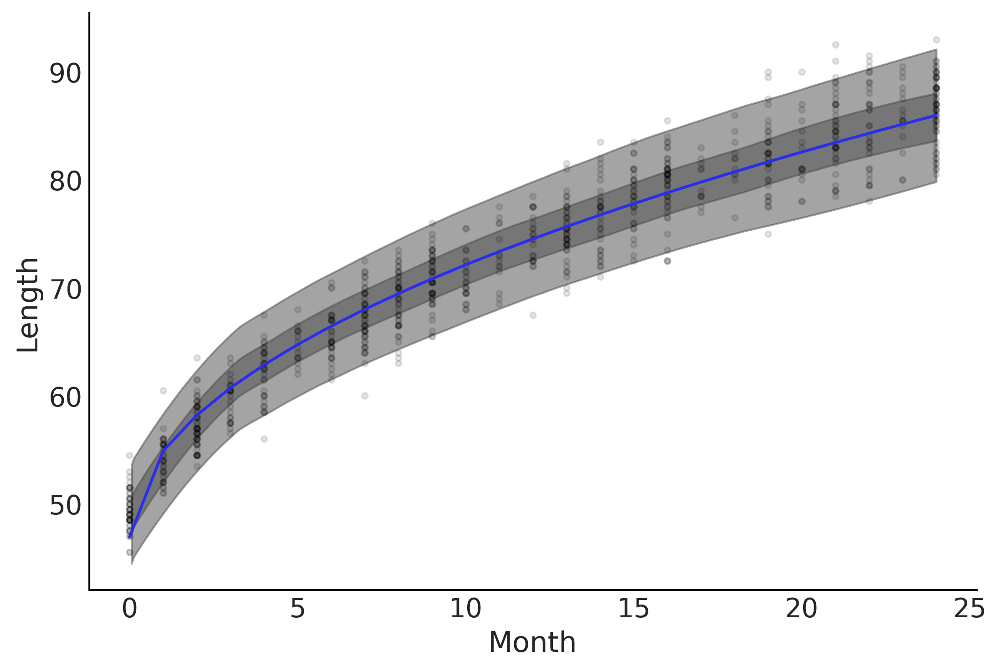

In [14]:
fig, ax = plt.subplots()

ax.set_ylabel("Length")
ax.set_xlabel("Month");

ax.plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

μ_m = idata_baby_vv.posterior["μ"].mean(("chain", "draw"))

ax.plot(babies["Month"], μ_m, c='C4')

az.plot_hdi(babies["Month"], idata_baby_vv.posterior_predictive["length"], hdi_prob=.50, ax=ax)
az.plot_hdi(babies["Month"], idata_baby_vv.posterior_predictive["length"], hdi_prob=.94, ax=ax)

plt.savefig('img/chp04/baby_length_sqrt_vv_fit.png', dpi=300)

To model increasing dispersion of the length of as the observed children
get older we changed our definition of $\sigma$ from a fixed value to a
value that varies as a function of age. In other words we change the
model assumption from **homoscedastic**, that is having constant
variance, to **heteroscedastic**, that is having varying variance. In
our model, defined in Code Block
[babies_varying_variance](babies_varying_variance) all we
need to do is change the expression defining $\sigma$ of our model and
the PPL handle the estimation for us . The results of this model are
plotted in {numref}`fig:Baby_Length_Sqrt_VV_Fit_Include_Error`.

```{figure} figures/Baby_Length_Sqrt_VV_Fit_Include_Error.png
:name: fig:Baby_Length_Sqrt_VV_Fit_Include_Error
:width: 7.00in
Two plots showing parameter fits of baby month versus length. In the top
plot the expected mean prediction, represented with a blue line, is
identical to {numref}`fig:Baby_Length_non_linear`, however, the HDI
intervals of the posterior are non-constant. The bottom graph plots the
expected error estimate $\sigma$ as a function of age in months. Note
how the expected estimate of error increases as months increase.
```

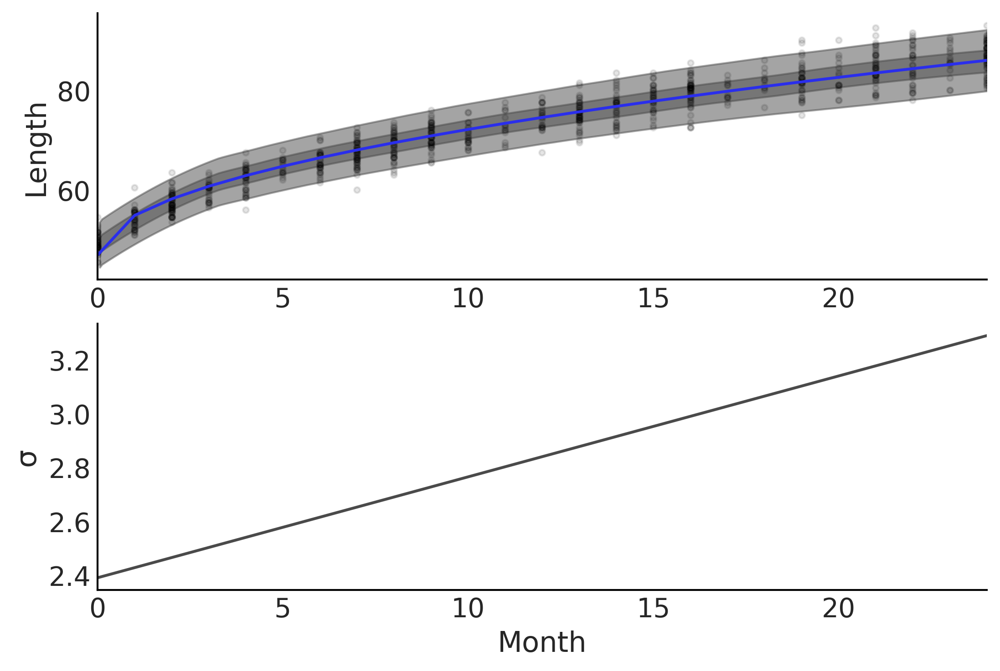

In [15]:
fig, axes = plt.subplots(2,1)

axes[0].plot(babies["Month"], babies["Length"], 'C0.', alpha=0.1)

μ_m = idata_baby_vv.posterior["μ"].mean(("chain", "draw"))

axes[0].plot(babies["Month"], μ_m, c='C4')

az.plot_hdi(babies["Month"], idata_baby_vv.posterior_predictive["length"], hdi_prob=.50, ax=axes[0])
az.plot_hdi(babies["Month"], idata_baby_vv.posterior_predictive["length"], hdi_prob=.94, ax=axes[0])
axes[0].set_ylabel("Length")

σ_m = idata_baby_vv.posterior["σ"].mean(("chain", "draw"))

axes[1].plot(babies["Month"], σ_m, c='C1')

axes[1].set_ylabel("σ")
axes[1].set_xlabel("Month")

axes[0].set_xlim(0,24)
axes[1].set_xlim(0,24)

plt.savefig('img/chp04/baby_length_sqrt_vv_fit_include_error.png', dpi=300)

(interaction-effects)=

## 4.3 Interaction Effects

In all our models thus far, we have assumed the effect of one covariate
to the response variable is independent of any other covariates. This is
not always the case. Consider a situation where we want to model ice
cream sales for a particular town. We might say if there are many ice
cream shops, more ice cream is available so we expect a large volume of
ice cream purchases. But if this town in a cold climate with an average
daily temperature of -5 degrees Celsius, we doubt there would be many
sales of ice cream. However, in the converse scenario if the town was in
a hot desert with average temperature of 30 degrees Celsius, but there
are no ice cream stores, sales of ice cream would also be low. It is
only when there is both hot weather *and* there are many places to buy
ice cream that we expect an increased volume of sales. Modeling this
kind of joint phenomena requires that we introduce an *interaction
effect*, where the effect of one covariate on the output variable
depends on the value of other covariates. Thus, if we assume covariates
to contribute independently (as in a standard linear regression model),
we will not be able to fully explain the phenomena. We can express an
interaction effect as:

```{math} 
:label: eq:interaction_effect

\begin{split}
    \mu =& \beta_0 + \beta_1 X_1 + \beta_2 X_2 + \beta_3 X_1X_2\\
    Y \sim& \mathcal{N}(\mu, \sigma)
\end{split}
```

where $\beta_3$ is the coefficient for the interaction term $X_1X_2$.
There are other ways to introduce interactions but computing the
products of original covariates is a very widely used option. Now that
we have defined what an interaction effect is we can by contrast define
a main effect, as the effect of one covariate on the dependent variable
while ignoring all other covariates.

To illustrate let us use another example where we model the amount of
tip a diner leaves as a function of the total bill in Code Block
[tips_no_interaction](tips_no_interaction). This sounds
reasonable as the amount of the tip is generally calculated as a
percentage of the total bill with the exact percentage varying by
different factors like the kind of place you are eating, the quality of
the service, the country you are living, etc. In this example we are
going to focus on the difference in tip amount from smokers versus
non-smokers. In particular, we will study if there is an interaction
effect between smoking and the total bill amount [^2]. Just like Model
[penguin_mass_multi](penguin_mass_multi) we can include
smokers as an independent categorical variable in our regression.

```{code-block} python
:name: tips_no_interaction
:caption: tips_no_interaction

tips_df = pd.read_csv("../data/tips.csv")
tips = tips_df["tip"]
total_bill_c = (tips_df["total_bill"] - tips_df["total_bill"].mean())  
smoker = pd.Categorical(tips_df["smoker"]).codes

with pm.Model() as model_no_interaction:
    β = pm.Normal("β", mu=0, sigma=1, shape=3)
    σ = pm.HalfNormal("σ", 1)

    μ = (β[0] +
         β[1] * total_bill_c + 
         β[2] * smoker)

    obs = pm.Normal("obs", μ, σ, observed=tips)
    trace_no_interaction = pm.sample(1000, tune=1000)
```

[^2]: Remember this is just a toy dataset, so the take-home message
    should be about modeling interactions and not about tips.

In [16]:
tips_df = pd.read_csv('../data/tips.csv')
tips_df.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


In [17]:
tips = tips_df["tip"]
total_bill_c = (tips_df["total_bill"] - tips_df["total_bill"].mean())  
smoker = pd.Categorical(tips_df["smoker"]).codes

with pm.Model() as model_no_interaction:
    β = pm.Normal("β", mu=0, sigma=1, shape=3)
    σ = pm.HalfNormal("σ", 1)

    μ = (β[0] +
         β[1] * total_bill_c + 
         β[2] * smoker)

    obs = pm.Normal("obs", μ, σ, observed=tips)
    idata_no_interaction = pm.sample(1000, tune=1000)

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.


In [18]:
idata_no_interaction.posterior

<xarray.Dataset> Size: 136kB
Dimensions:  (chain: 4, draw: 1000, β_dim_0: 3)
Coordinates:
  * chain    (chain) int64 32B 0 1 2 3
  * draw     (draw) int64 8kB 0 1 2 3 4 5 6 7 ... 993 994 995 996 997 998 999
  * β_dim_0  (β_dim_0) int64 24B 0 1 2
Data variables:
    β        (chain, draw, β_dim_0) float64 96kB 3.04 0.1097 ... 0.12 -0.3119
    σ        (chain, draw) float64 32kB 1.009 0.9993 1.051 ... 1.092 0.9373
Attributes:
    created_at:                 2025-01-24T15:34:13.122837+00:00
    arviz_version:              0.20.0
    inference_library:          pymc
    inference_library_version:  5.20.0
    sampling_time:              1.314394474029541
    tuning_steps:               1000

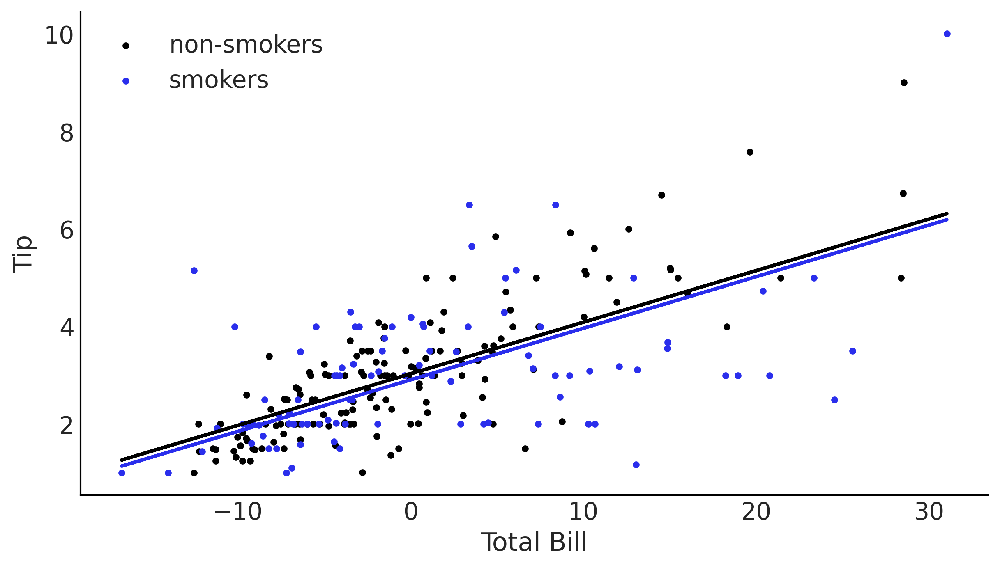

In [19]:
_, ax = plt.subplots(figsize=(8, 4.5))

total_bill_c_da = xr.DataArray(total_bill_c)

posterior_no_interaction = az.extract(idata_no_interaction, var_names=["β"])

β0_nonint = posterior_no_interaction.sel(β_dim_0=0)
β1_nonint = posterior_no_interaction.sel(β_dim_0=1)
β2_nonint = posterior_no_interaction.sel(β_dim_0=2)

pred_y_non_smokers = β0_nonint + β1_nonint * total_bill_c_da
pred_y_smokers = β0_nonint + β1_nonint * total_bill_c_da + β2_nonint

ax.scatter(total_bill_c[smoker==0], tips[smoker==0], label='non-smokers', marker='.')
ax.scatter(total_bill_c[smoker==1], tips[smoker==1], label='smokers', marker='.', c="C4")
ax.set_xlabel('Total Bill')
ax.set_ylabel('Tip')
ax.legend()

ax.plot(total_bill_c, pred_y_non_smokers.mean("sample"), lw=2)
ax.plot(total_bill_c, pred_y_smokers.mean("sample"), lw=2, c="C4");

Let us also create a model where we include an interaction term in Code
Block [tips_interaction](tips_interaction).

```{code-block} python
:name: tips_interaction
:caption: tips_interaction

with pm.Model() as model_interaction:
    β = pm.Normal("β", mu=0, sigma=1, shape=4)
    σ = pm.HalfNormal("σ", 1)

    μ = (β[0]
       + β[1] * total_bill_c
       + β[2] * smoker
       + β[3] * smoker * total_bill_c
        )

    obs = pm.Normal("obs", μ, σ, observed=tips)
    trace_interaction = pm.sample(1000, tune=1000)
```

```{figure} figures/Smoker_Tip_Interaction.png
:name: fig:Smoker_Tip_Interaction
:width: 7.00in
Plots of linear estimates from our two tips models. On the right we show
the non-interaction estimate from Code Block
[tips_no_interaction](tips_no_interaction), where the
estimated lines are parallel. On the left we show our model from Code
Block [tips_no_interaction](tips_no_interaction) that
includes an interaction term between smoker or non-smoker and bill
amount. In the interaction model the slopes between the groups are
allowed to vary due to the added interaction term.
```

In [20]:
with pm.Model() as model_interaction:
    β = pm.Normal('β', mu=0, sigma=1, shape=4)
    σ = pm.HalfNormal('σ', 1)

    μ = (β[0] +
         β[1] * total_bill_c + 
         β[2] * smoker +
         β[3] * smoker * total_bill_c
        )

    obs = pm.Normal('obs', μ, σ, observed=tips)
    idata_interaction = pm.sample(1000, tune=1000)

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [β, σ]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.


/home/hwting/anaconda3/envs/rapids/lib/python3.11/site-packages/arviz/plots/hdiplot.py:161: FutureWarning: hdi currently interprets 2d data as (draw, shape) but this will change in a future release to (chain, draw) for coherence with other functions
  hdi_data = hdi(y, hdi_prob=hdi_prob, circular=circular, multimodal=False, **hdi_kwargs)
/home/hwting/anaconda3/envs/rapids/lib/python3.11/site-packages/arviz/plots/hdiplot.py:161: FutureWarning: hdi currently interprets 2d data as (draw, shape) but this will change in a future release to (chain, draw) for coherence with other functions
  hdi_data = hdi(y, hdi_prob=hdi_prob, circular=circular, multimodal=False, **hdi_kwargs)
/home/hwting/anaconda3/envs/rapids/lib/python3.11/site-packages/arviz/plots/hdiplot.py:161: FutureWarning: hdi currently interprets 2d data as (draw, shape) but this will change in a future release to (chain, draw) for coherence with other functions
  hdi_data = hdi(y, hdi_prob=hdi_prob, circular=circular, multimodal=F

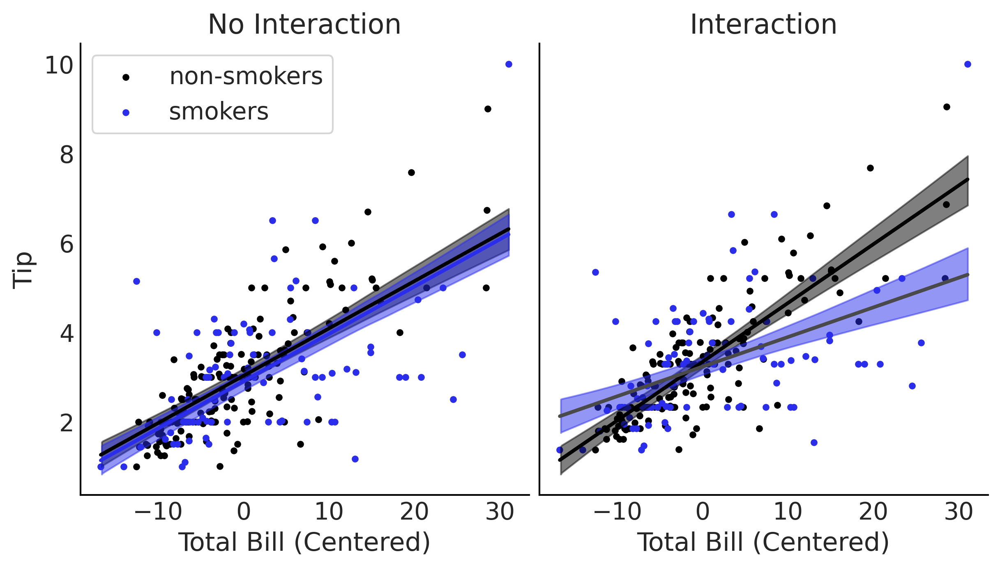

In [21]:
_, ax = plt.subplots(1, 2, figsize=(8, 4.5))

posterior_no_interaction = az.extract(idata_no_interaction, var_names=["β"])

β0_nonint = posterior_no_interaction.sel(β_dim_0=0)
β1_nonint = posterior_no_interaction.sel(β_dim_0=1)
β2_nonint = posterior_no_interaction.sel(β_dim_0=2)

pred_y_non_smokers = β0_nonint + β1_nonint * total_bill_c_da
pred_y_smokers = β0_nonint + β1_nonint * total_bill_c_da + β2_nonint

ax[0].scatter(total_bill_c[smoker==0], tips[smoker==0], label='non-smokers', marker='.')
ax[0].scatter(total_bill_c[smoker==1], tips[smoker==1], label='smokers', marker='.', c="C4")
ax[0].set_xlabel('Total Bill (Centered)')
ax[0].set_ylabel('Tip')
ax[0].legend(frameon=True)

ax[0].plot(total_bill_c, pred_y_non_smokers.mean("sample"), lw=2)
ax[0].plot(total_bill_c, pred_y_smokers.mean("sample"), lw=2, c="C4")
ax[0].set_title('No Interaction')


az.plot_hdi(total_bill_c, pred_y_non_smokers, color='C0', ax=ax[0])
az.plot_hdi(total_bill_c, pred_y_smokers, ax=ax[0], color="C4");


posterior_interaction = az.extract(idata_interaction, var_names=["β"])

β0_int = posterior_interaction.sel(β_dim_0=0)
β1_int = posterior_interaction.sel(β_dim_0=1)
β2_int = posterior_interaction.sel(β_dim_0=2)
β3_int = posterior_interaction.sel(β_dim_0=3)


# Because smoker=0 I am omitting the terms including the smoker covariate
pred_y_non_smokers = (β0_int +
                      β1_int * total_bill_c_da)

# Because x1=1 I am ommiting x1
pred_y_smokers = (β0_int +
                  β1_int * total_bill_c_da +
                  β2_int +
                  β3_int * total_bill_c_da)


ax[1].scatter(total_bill_c[smoker==0], tips[smoker==0], label='non-smokers', marker='.')
ax[1].scatter(total_bill_c[smoker==1], tips[smoker==1], label='smokers', marker='.', c="C4")
ax[1].set_xlabel('Total Bill (Centered)')
ax[1].set_yticks([])

ax[1].set_title('Interaction')

ax[1].plot(total_bill_c, pred_y_non_smokers.mean("sample"), lw=2)
ax[1].plot(total_bill_c, pred_y_smokers.mean("sample"), lw=2)
az.plot_hdi(total_bill_c, pred_y_non_smokers, color='C0', ax=ax[1])
az.plot_hdi(total_bill_c, pred_y_smokers, ax=ax[1], color="C4");

plt.savefig('img/chp04/smoker_tip_interaction.png', dpi=300)

The difference is visible in {numref}`fig:Smoker_Tip_Interaction`.
Comparing the non-interaction model on the left and the interaction on
the right, the mean fitted lines are no longer parallel, the slopes for
smokers and non-smokers are different! By introducing an interaction we
are building a model that is effectively splitting the data, in this
example into two categories, smokers and non-smokers. You may be
thinking that it is a better idea to split the data manually and fit two
separate models, one for the smokers and one for the non-smokers. Well,
not so fast. One of the benefits of using interactions is that we are
using all the available data to fit a single model, increasing the
accuracy of the estimated parameters. For example, notice that by using
a single model we are assuming that $\sigma$ is not affected by the
variable `smoker` and thus $\sigma$ is estimated from both smokers and
non-smokers, helping us to get a better estimation of this parameter.
Another benefit is that we get an estimate of the size effect of the
interaction. If we just split the data we are implicitly assuming the
interaction is exactly 0, by modeling the interaction we get an estimate
about how strong the interaction is. Finally, building a model with and
without interactions for the same data to make easier to compare models
using LOO. If we split the data we end-up with different models
evaluated on different data, instead of different models evaluated on
the same data, which is a requisite for using LOO. So in summary, while
the primary difference in interaction effect models is flexibility in
modeling different slopes per group, there are many additional benefits
that arise from modeling all the data together.


(robust_regression)=

## 4.4 Robust Regression

Outliers, as the name suggests, are observations that lie outside of the
range "reasonable expectation\". Outliers are undesirable, as one, or
few, of these data points could change the parameter estimation of a
model significantly. There are a variety of suggested formal methods
{cite:p}`grubbs_1969` of handling outliers, but in practice how outliers are
handled is a choice a statistician has to make (as even the choice of a
formal method is subjective). In general though there are at least two
ways to address outliers. One is removing data using some predefined
criteria, like 3 standard deviations or 1.5 times the interquartile
range. Another strategy is choosing a model that can handle outliers and
still provide useful results. In regression the latter are typically
referred to as robust regression models, specifically to note these
models are less sensitive to observations away from the bulk of the
data. Technically speaking, robust regression are methods designed to be
less affected by violations of assumptions by the underlying
data-generating process. In Bayesian regression one example is changing
the likelihood from a Gaussian distribution to a Student's
t-distribution.

Recall that Gaussian distributions are defined by two parameters
typically known as location $\mu$ and scale $\sigma$. These parameters
control the mean and standard deviation of the Gaussian distribution.
Student's t-distributions also have one parameter for the location and
scale respectively [^3]. However, there is an additional parameter,
typically known as degrees of freedom $\nu$. This parameter controls the
weight of the tails of the Student's t-distribution, as shown in
{numref}`fig:StudentT_Normal_Comparison`. Comparing the 3 Student's
t-distributions against each other and the Normal distribution, the key
difference is the proportion of the density in the tails versus the
proportion at the bulk of the distributions. When $\nu$ is small there
is more mass distributed in the tails, as the value of $\nu$ increases
the proportion of density concentrated towards the bulk also increases
and the Student's t-distribution becomes closer and closer to the
Gaussian. Practically speaking what this means is that values farther
from the mean are more likely to occur when $\nu$ is small. Which
provides robustness to outliers when substituting a Gaussian likelihood
with a Student's t-distribution.

```{figure} figures/StudentT_Normal_Comparison.png
:name: fig:StudentT_Normal_Comparison
:width: 7.00in
Normal distribution, in blue, compared to 3 Student's t-distributions
with varying $\nu$ parameters. The location and scale parameters are all
identical, which isolates the effect $\nu$ has on the tails of the
distribution. Smaller values of $\nu$ put more density into the tails of
the distribution.
```

This can be shown in an example. Say you own a restaurant in Argentina
and you sell empanadas [^4]. Over time you have collected data on the
number of customers per day and the total amount of Argentine pesos your
restaurant has earned, as shown in {numref}`fig:Empanada_Scatter_Plot`.
Most of the data points fall along a line, except during a couple of
days where the number of empanadas sold per customer is much higher than
the surrounding data points. These may be days of big celebration such
as the 25th of May or 9th of July [^5], where people are consuming more
empanadas than usual.

```{figure} figures/Empanada_Scatter_Plot.png
:name: fig:Empanada_Scatter_Plot
:width: 7.00in
Simulated data of number of customers plotted against the pesos
returned. The 5 dots at the top of the chart are considered outliers.
```

[^4]: A thin dough filled with a salty or sweet preparation and baked or
    fried. The filling can include red or white meat, fish, vegetables,
    or fruit. Empanadas are common in Southern European, Latin American,
    and the Filipino cultures.

[^5]: The commemoration of the first Argentine government and the
    Argentine independence day respectively.

[^3]: Although the mean is defined only for $\nu > 1$, and the value of
    $\sigma$ agrees with the standard deviation only when
    $\nu \to \infty$.

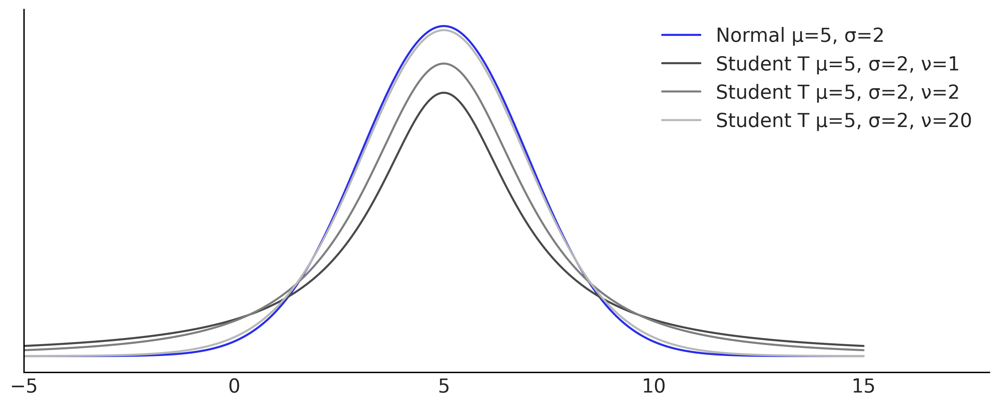

In [22]:
mean = 5
sigma = 2

x = np.linspace(-5, 15, 1000)
fig, ax = plt.subplots(figsize=(10, 4))

ax.plot(x, stats.norm(5,2).pdf(x), label=f"Normal μ={mean}, σ={sigma}", color="C4")

for i, nu in enumerate([1, 2, 20],1):
    ax.plot(x, stats.t(loc=5, scale=2, df=nu).pdf(x), label=f"Student T μ={mean}, σ={sigma}, ν={nu}", color=f"C{i}")

ax.set_xlim(-5, 18)
ax.legend(loc="upper right", frameon=False)
ax.set_yticks([])
plt.savefig('img/chp04/studentt_normal_comparison.png', dpi=300)

In [23]:
def generate_sales(*, days, mean, std, label):
    np.random.seed(0)
    df = pd.DataFrame(index=range(1, days+1), columns=["customers", "sales"])
    for day in range(1, days+1):
        num_customers = stats.randint(30, 100).rvs()+1
        
        # This is correct as there is an independent draw for each customers orders
        dollar_sales = stats.norm(mean, std).rvs(num_customers).sum()
        
        df.loc[day, "customers"] = num_customers
        df.loc[day, "sales"] = dollar_sales
        
    # Fix the types as not to cause Theano errors
    df = df.astype({'customers': 'int32', 'sales': 'float32'})
    
    # Sorting will make plotting the posterior predictive easier later
    df["Food_Category"] = label
    df = df.sort_values("customers")
    return df


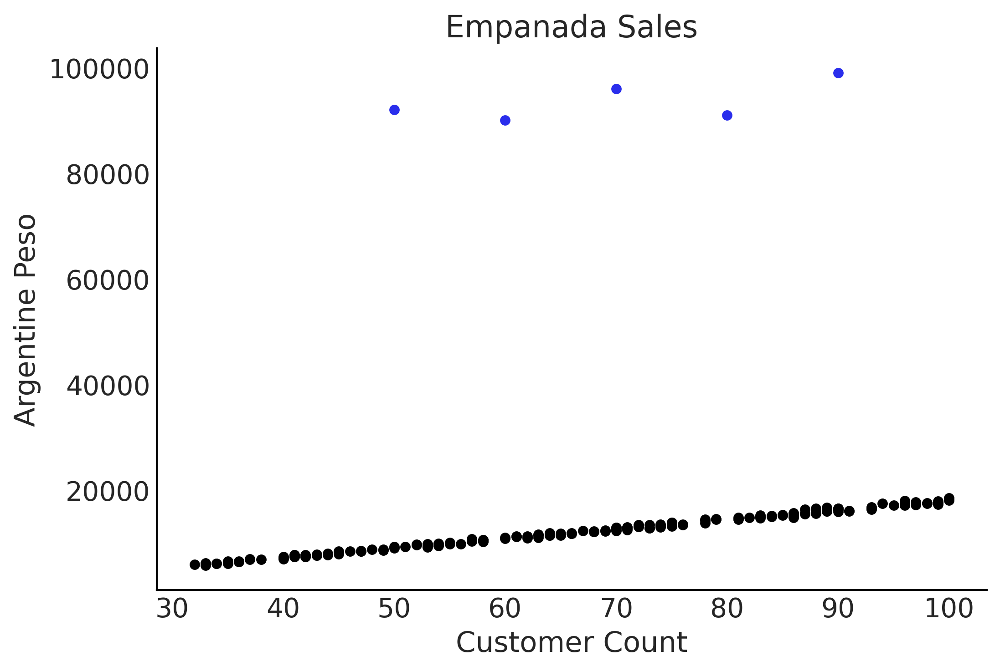

In [24]:
fig, ax = plt.subplots()

empanadas =  generate_sales(days=200, mean=180, std=30, label="Empanada")
empanadas.iloc[0] = [50, 92000, "Empanada"]
empanadas.iloc[1] = [60, 90000, "Empanada"]
empanadas.iloc[2] = [70, 96000, "Empanada"]
empanadas.iloc[3] = [80, 91000, "Empanada"]
empanadas.iloc[4] = [90, 99000, "Empanada"]

empanadas = empanadas.sort_values("customers")

empanadas.sort_values("sales")[:-5].plot(x="customers", y="sales", kind="scatter", ax=ax);
empanadas.sort_values("sales")[-5:].plot(x="customers", y="sales", kind="scatter", c="C4", ax=ax);

ax.set_ylabel("Argentine Peso")
ax.set_xlabel("Customer Count")
ax.set_title("Empanada Sales")
plt.savefig('img/chp04/empanada_scatter_plot.png', dpi=300)

Regardless of the outliers, we want to estimate the relationship between
our customers and revenue. When plotting the data a linear regression
seems appropriate, such as the one written in Code Block
[non_robust_regression](non_robust_regression) which uses
a Gaussian likelihood. After estimating the parameters we plot the mean
regression in {numref}`fig:Empanada_Scatter_Non_Robust` at two different
scales. In the lower plot note how the fitted regression line lies above
all visible data points. In {numref}`tab:non_robust_regression` we
also can see the individual parameter estimates, noting in particular
$\sigma$ which at a mean value of 574 seems high when compared to the
plot of the nominal data. With a Normal likelihood the posterior
distribution has to "stretch\" itself over the nominal observations and
the 5 outliers, which affects the estimates. Additionally, note how the
estimate of $\sigma$ is quite wide compared to the plotted data in
{numref}`fig:Empanada_Scatter_Non_Robust`.

```{code-block} python
:name: non_robust_regression
:caption: non_robust_regression

with pm.Model() as model_non_robust:
    σ = pm.HalfNormal("σ", 50)
    β = pm.Normal("β", mu=150, sigma=20)

    μ = pm.Deterministic("μ", β * empanadas["customers"])

    sales = pm.Normal("sales", mu=μ, sigma=σ, observed=empanadas["sales"])
    
    inf_data_non_robust = pm.sample()
```

```{figure} figures/Empanada_Scatter_Non_Robust.png
:name: fig:Empanada_Scatter_Non_Robust
:width: 7.00in
A plot of the data, fitted regression line, and 94% HDI of
`model_non_robust` from Code Block
[non_robust_regression](non_robust_regression) at two
scales, the top including the outliers, and the bottom focused on the
regression itself. The systemic bias is more evident in bottom plot as
the mean regression line is estimated to be above the nominal data
points.
```

```{list-table} Estimate of parameters for model non_robust_regression.
:name: tab:non_robust_regression
* -
  - **mean**
  - **sd**
  - **hdi_3%**
  - **hdi_97%**
* - $\beta$
  - 207.1
  -   2.9
  - 201.7
  - 212.5
* - $\sigma$
  - 2951.1
  -   25.0
  - 2904.5
  - 2997.7
```

In [25]:
with pm.Model() as model_non_robust:
    σ = pm.HalfNormal("σ", 50)
    β = pm.Normal('β', mu=150, sigma=20)

    μ = pm.Deterministic("μ", β * empanadas["customers"])
    
    sales = pm.Normal("sales", mu=μ, sigma=σ, observed=empanadas["sales"])
    
    idata_non_robust = pm.sample(random_seed=1, idata_kwargs={"log_likelihood": True})
    idata_non_robust.extend(pm.sample_posterior_predictive(idata_non_robust))

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.
Sampling: [sales]


Output()

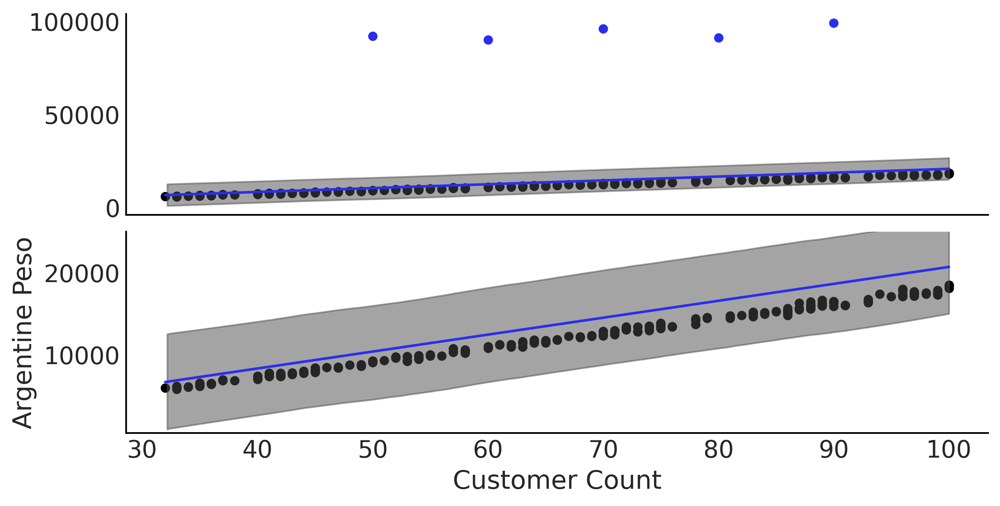

In [26]:
fig, axes = plt.subplots(2, 1, figsize=(8, 4), sharex=True)
μ_m = idata_non_robust.posterior["μ"].mean(("chain", "draw"))

for i in range(2):
    empanadas.sort_values("sales")[:-5].plot(x="customers", y="sales", kind="scatter", ax=axes[i]);
    empanadas.sort_values("sales")[-5:].plot(x="customers", y="sales", kind="scatter", c="C4", ax=axes[i]);
    axes[i].plot(empanadas.customers, μ_m, c='C4')
    az.plot_hdi(empanadas.customers, idata_non_robust.posterior_predictive["sales"], hdi_prob=.95, ax=axes[i])

    axes[1].set_ylabel("Argentine Peso")

axes[0].set_ylabel("")
axes[1].set_xlabel("Customer Count")
axes[1].set_ylim(400, 25000);
plt.savefig('img/chp04/empanada_scatter_non_robust.png', dpi=300)

In [27]:
az.summary(idata_non_robust, kind="stats", var_names=["β", "σ"]).round(1)

,mean,sd,hdi_3%,hdi_97%
β,207.0,2.9,201.7,212.5
σ,2950.9,24.8,2905.2,2997.4


We can run the same regression again but this time using the Student's
t-distribution as likelihood, shown in Code Block
[code_robust_regression](code_robust_regression). Note that the
dataset has not changed and the outliers are still included. When
inspecting the fitted regression line in
{numref}`fig:Empanada_Scatter_Robust` we can see that the fit falls
between the nominal observed data points, closer to where we would
expect. Inspecting the mean parameter estimates in {numref}`tab:robust_regression`
note the addition of the extra parameter
$\nu$. Furthermore we can see that the estimate of $\sigma$ has fallen
substantially from $\approx$ 2951 pesos in the non-robust regression to
$\approx$ 152 pesos in the robust regression, note how  this new estiamte is logically reasonable
compared to the plotted data. The change in likelihood
distribution shows that there is enough flexibility in the Student's
t-distribution to reasonably model the nominal data, despite the
presence of outliers.


```{code-block} python
:name: code_robust_regression
:caption: code_robust_regression

with pm.Model() as model_robust:
    σ = pm.HalfNormal("σ", 50)
    β = pm.Normal("β", mu=150, sigma=20)
    ν = pm.HalfNormal("ν", 20)

    μ = pm.Deterministic("μ", β * empanadas["customers"])
    
    sales = pm.StudentT("sales", mu=μ, sigma=σ, nu=ν,
                        observed=empanadas["sales"])

    inf_data_robust = pm.sample()
```


```{list-table} Estimate of parameters for model robust_regression.
:name: tab:robust_regression
* -
  - **mean**
  - **sd**
  - **hdi_3%**
  - **hdi_97%**
* - $\beta$
  - 179.6
  -   0.3
  - 179.1
  - 180.1
* - $\sigma$
  - 152.3
  -  13.9
  - 127.1
  - 179.5
* - $\nu$
  - 1.3
  - 0.2
  - 1.0
  - 1.6
```


```{figure} figures/Empanada_Scatter_Robust.png
:name: fig:Empanada_Scatter_Robust
:width: 7.00in
A plot of the data, fitted regression line of `model_robust` and 94% HDI
from Code Block [code_robust_regression](code_robust_regression).
The outliers are not plotted but are present in the data. The fitted
line falls within the range of the nominal data points, particularly if
compared to {numref}`fig:Empanada_Scatter_Non_Robust`.
```

In [28]:
with pm.Model() as model_robust:
    σ = pm.HalfNormal("σ", 50)
    β = pm.Normal("β", mu=150, sigma=20)
    ν = pm.HalfNormal("ν", 20)

    μ = pm.Deterministic("μ", β * empanadas["customers"])
    
    sales = pm.StudentT("sales", mu=μ, sigma=σ, nu=ν,
                        observed=empanadas["sales"])
        
    idata_robust  = pm.sample(random_seed=0, idata_kwargs={"log_likelihood": True})
    idata_robust.extend(pm.sample_posterior_predictive(idata_robust))

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β, ν]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.
Sampling: [sales]


Output()

In [29]:
az.summary(idata_robust, var_names=["β", "σ", "ν"], kind="stats").round(1)

,mean,sd,hdi_3%,hdi_97%
β,179.6,0.3,179.1,180.1
σ,152.2,13.8,125.8,176.9
ν,1.3,0.2,1.0,1.6


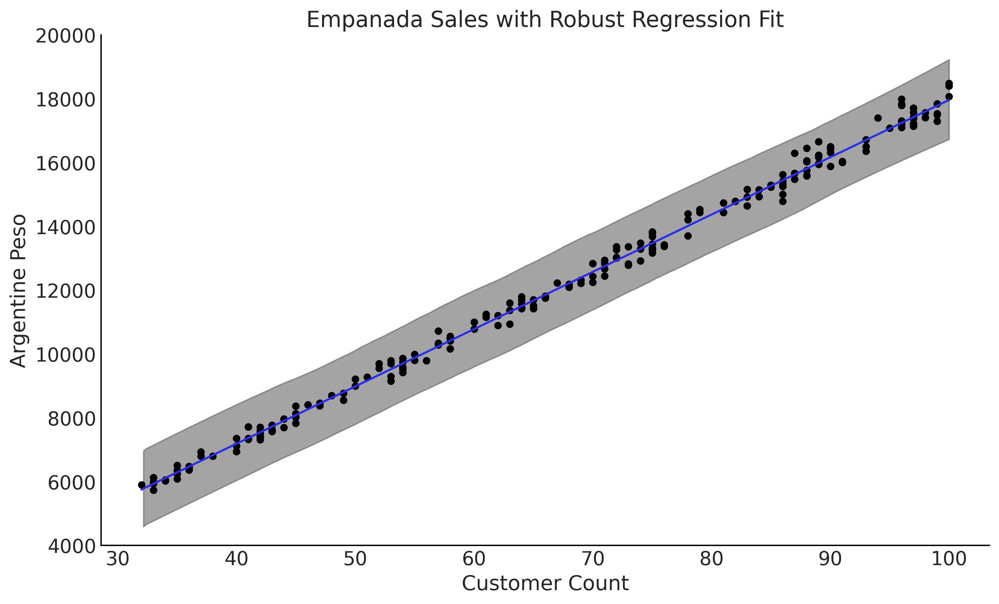

In [30]:
fig, ax = plt.subplots(figsize=(10, 6))
μ_m = idata_robust.posterior["μ"].mean(("chain", "draw"))
    
ax.plot(empanadas.customers, μ_m, c='C4')
az.plot_hdi(empanadas.customers, idata_robust.posterior_predictive["sales"], hdi_prob=.95, ax=ax)

empanadas.plot(x="customers", y="sales", kind="scatter", ax=ax)
ax.set_ylim(4000, 20000);
ax.set_ylabel("Argentine Peso")
ax.set_xlabel("Customer Count")
ax.set_title("Empanada Sales with Robust Regression Fit")
plt.savefig('img/chp04/empanada_scatter_robust.png', dpi=300)

In [31]:
az.compare({"Non robust": idata_non_robust,
            "Robust":idata_robust})

/home/hwting/anaconda3/envs/rapids/lib/python3.11/site-packages/arviz/stats/stats.py:795: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
Robust,0,-1473.663035,5.575329,0.000000,1.0,31.820644,0.000000,False,log
Non robust,1,-3692.128015,142.904259,2218.464979,0.0,826.403473,796.739709,True,log


In this example the "outliers\" are actually part of the problem we want
to model, in the sense that they are not measurement error, data entry
errors etc, but observations that can actually happened under certain
conditions. Hence, it is ok to treat them as outliers if we want to
model the average number of empanadas on a "regular\" day, but it will
lead to a disaster if we use this average to make plans for the next
25th of May or 9th of July. Therefore in this example the robust linear
regression model is a trick to avoid explicitly modeling the high sales
day which, if needed, will be probably better modeled using mixture
model or a multilevel model.

::: {admonition} Model adaptions for data considerations

Changing the likelihood to accommodate for robustness is just one example of a modification we can
make to the model to better suit the observed data. For example, in
detecting radioactive particle emission a zero count can arise because
of a faulty sensor{cite:p}`betancourt_2020_worfklow` (or some other measuring
problem), or because there was actually no event to register. This
unknown source of variation has the effect of *inflating* the count of
zeros. A useful aid for this kind of problem is the class of models
aptly named zero-inflated models which estimate the combined data
generating process. For example, a Poisson likelihood, which will
generally be a starting point for modeling counts, can be expanded into
a zero-inflated Poisson likelihood. With such a likelihood we can better
separate the counts generated from a Poisson process from those
generated from the *excess zero generating process*.

Zero-inflated models are an example of handling a mixture of data, in
which observations come from two or more groups, without knowledge of
which observation belongs to which group. Actually, we can express
another type of robust regression using a mixture likelihood, which
assigns a latent label (outlier or not) to each data point.

In all of these situations and many more the bespoke nature of Bayesian
models allows the modeler the flexibility to create a model that fits
the situation, rather than having to fit a situation to a predefined
model.
:::

(multilevel_models)=

## 4.5 Pooling, Multilevel Models, and Mixed Effects

Often we have dataset that contain additional nested structures among
the predictors, which gives some hierarchical way to group the data. We
can also think of it as different data generation processes. We are
going to use an example to illustrate this. Let us say you work at a
restaurant company which sells salads. This company has a
long-established business in some geographic markets and, due to
customer demand, has just opened a location in a new market as well. You
need to predict how many US dollars the restaurant location in this new
market will earn each day for financial planning purposes. You have two
datasets, 3 days of data for the sales of salads, as well as roughly a
year's worth of data on pizza and sandwich sales in the same market. The
(simulated) data is shown in {numref}`fig:Restaurant_Order_Scatter`.

```{figure} figures/Restaurant_Order_Scatter.png
:name: fig:Restaurant_Order_Scatter
:width: 7.00in
A simulated dataset for a real world scenario. In this case an
organization has 3 data points for the daily sales of salads, but has
lots of data on the sales of pizza and sandwiches.
```

From both expert knowledge and data, there is agreement that there are
similarities between the sales of these 3 food categories. They all
appeal to the same type of customer, represent the same "food category\"
of *quick to go* food but they are not exactly the same either. In the
following sections we will discuss how to model this
*similarity-yet-disimilarity* but let us start with the simpler case,
all groups are unrelated to each other.

In [32]:
def generate_sales(*, days, mean, std, label):
    np.random.seed(0)
    df = pd.DataFrame(index=range(1, days+1), columns=["customers", "sales"])
    for day in range(1, days+1):
        num_customers = stats.randint(30, 100).rvs()+1
        
        # This is correct as there is an independent draw for each customers orders
        dollar_sales = stats.norm(mean, std).rvs(num_customers).sum()
        
        df.loc[day, "customers"] = num_customers
        df.loc[day, "sales"] = dollar_sales
        
    # Fix the types as not to cause Theano errors
    df = df.astype({'customers': 'int32', 'sales': 'float32'})
    
    # Sorting will make plotting the posterior predictive easier later
    df["Food_Category"] = label
    df = df.sort_values("customers")
    return df


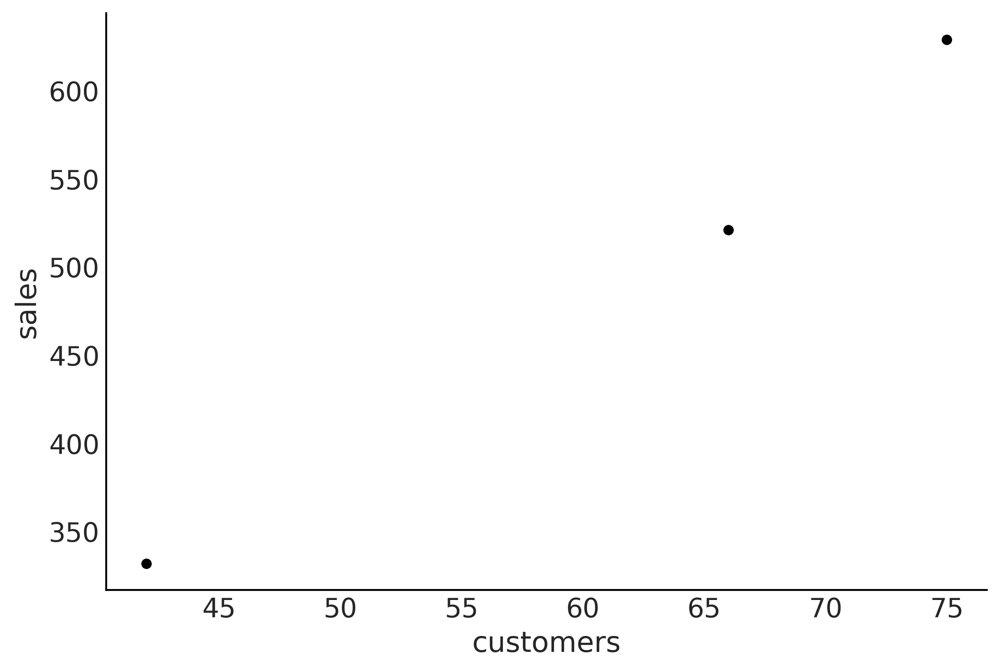

In [33]:
pizza_df = generate_sales(days=365, mean=13, std=5, label="Pizza")
sandwich_df = generate_sales(days=100, mean=6, std=5, label="Sandwich")

salad_days = 3
salad_df = generate_sales(days=salad_days, mean=8 ,std=3, label="Salad")

salad_df.plot(x="customers", y="sales", kind="scatter");

In [34]:
sales_df = pd.concat([pizza_df, sandwich_df, salad_df]).reset_index(drop=True)
sales_df["Food_Category"] = pd.Categorical(sales_df["Food_Category"])
sales_df

,customers,sales,Food_Category
0,31,459.895203,Pizza
1,31,401.147736,Pizza
2,31,413.345245,Pizza
3,31,371.909241,Pizza
4,32,433.797089,Pizza
...,...,...,...
463,100,611.736816,Sandwich
464,100,667.152954,Sandwich
465,42,331.625702,Salad
466,66,520.900940,Salad


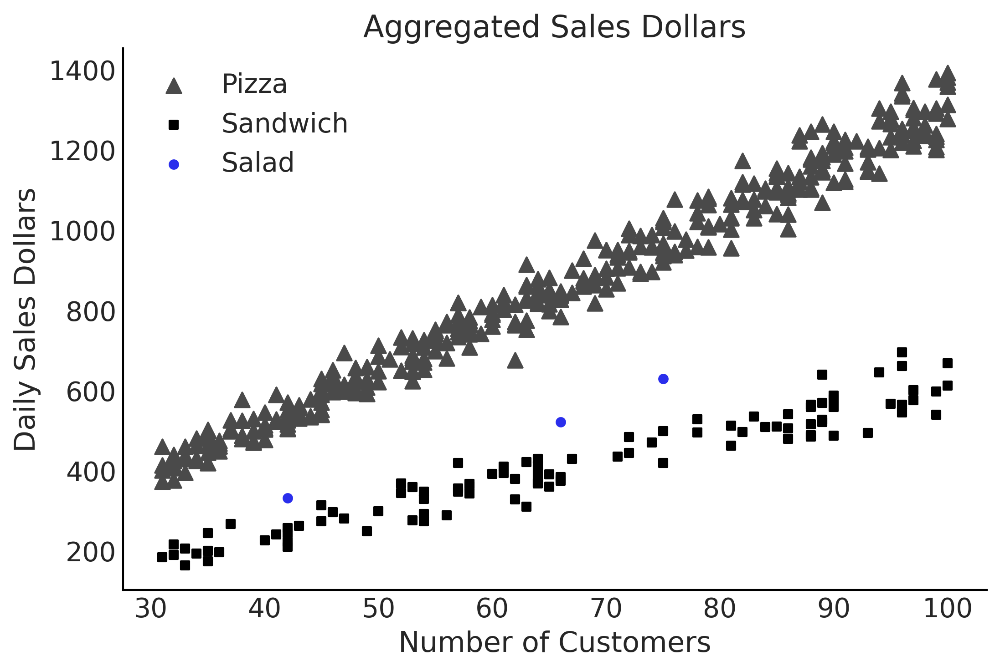

In [35]:
fig, ax = plt.subplots()
pizza_df.plot(x="customers", y="sales", kind="scatter", ax=ax, c="C1", label="Pizza", marker="^", s=60);
sandwich_df.plot(x="customers", y="sales", kind="scatter", ax=ax,  label="Sandwich", marker="s");
salad_df.plot(x="customers", y="sales", kind="scatter", ax=ax, label="Salad", c="C4");

ax.set_xlabel("Number of Customers")
ax.set_ylabel("Daily Sales Dollars")
ax.set_title("Aggregated Sales Dollars")
ax.legend()

plt.savefig('img/chp04/restaurant_order_scatter.png', dpi=300)

(unpooled-parameters)=

### 4.5.1 Unpooled Parameters

We can create a regression model where we treat each group, in this case
food category, as completely separated from the others. This is
identical to running a separate regression for each category, and that
is why we call it unpooled regression. The only difference to run
separated regression is that we are writing a single model and
estimating all coefficients at the same time. The relationship between
parameters and groups is visually represented in
{numref}`fig:unpooled_model` and in mathematical notation in Equation
{eq}`eq:unpooled_regression`, where $j$ is an index identifying each
separated group.

```{figure} figures/unpooled_model.png
:name: fig:unpooled_model
:width: 5.00in
An unpooled model where each group of observations, $y_1, y_2, ..., y_j$
has its own set of parameters, independent from any other group.
```

```{math} 
:label: eq:unpooled_regression
\begin{split}
\beta_{mj} \sim& \overbrace{\mathcal{N}(\mu_{\beta m}, \sigma_{\beta m})}^{\text{Group-specific}}\\
\sigma_{j} \sim& \overbrace{\mathcal{HN}(\sigma_{\sigma})}^{\text{Group-specific}}\\
\mu_{j} =& \beta_{1j} X_1 + \dots + \beta_{mj} X_m \\
Y \sim& \mathcal{N}(\mu_{j}, \sigma_{j})
\end{split}

```

The parameters are labeled as *group-specific* parameters to denote
there is one dedicated to each group. The unpooled PyMC3 model, and some
data cleaning, is shown in Code Block
[model_sales_unpooled](model_sales_unpooled) and the block
representation is shown in
{numref}`fig:Salad_Sales_Basic_Regression_Model_Unpooled`. We do not
include an intercept parameter for the simple reason that if a
restaurant has zero customers, total sales will also be zero, so there
is neither any interest nor any need for the extra parameter.

```{code-block} python
:name: model_sales_unpooled
:caption: model_sales_unpooled

customers = sales_df.loc[:, "customers"].values
sales_observed = sales_df.loc[:, "sales"].values
food_category = pd.Categorical(sales_df["Food_Category"])

with pm.Model() as model_sales_unpooled:
    σ = pm.HalfNormal("σ", 20, shape=3)
    β = pm.Normal("β", mu=10, sigma=10, shape=3)
    
    μ = pm.Deterministic("μ", β[food_category.codes] *customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ[food_category.codes],
                      observed=sales_observed)
    
    trace_sales_unpooled = pm.sample(target_accept=.9)
    inf_data_sales_unpooled = az.from_pymc3(
        trace=trace_sales_unpooled, 
        coords={"β_dim_0":food_category.categories,
                "σ_dim_0":food_category.categories})
```

```{figure} figures/Salad_Sales_Basic_Regression_Model_Unpooled.png
:name: fig:Salad_Sales_Basic_Regression_Model_Unpooled
:width: 3.00in
A diagram of `model_sales_unpooled`. Note how the box around parameters
$\beta$ and $\sigma$ has a three in the lower right, indicating that the
model estimated 3 parameters each for $\beta$ and $\sigma$.
```

In [36]:
customers = sales_df.loc[:, "customers"].values
sales_observed = sales_df.loc[:, "sales"].values
food_category = pd.Categorical(sales_df["Food_Category"])

coords = {"meals":food_category.categories}

with pm.Model(coords=coords) as model_sales_unpooled:
    σ = pm.HalfNormal("σ", 20, dims="meals")
    β = pm.Normal("β", mu=10, sigma=10, dims="meals")
    
    μ = pm.Deterministic("μ", β[food_category.codes] *customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ[food_category.codes],
                      observed=sales_observed)
    
    idata_sales_unpooled = pm.sample(target_accept=.9)

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.
There were 1 divergences after tuning. Increase `target_accept` or reparameterize.


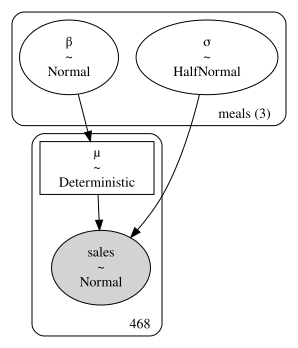

In [37]:
sales_unpooled_diagram = pm.model_to_graphviz(model_sales_unpooled)
sales_unpooled_diagram.render("img/chp04/salad_sales_basic_regression_model_unpooled", format="png", cleanup=True)
sales_unpooled_diagram

In [38]:
idata_salads_sales_unpooled = idata_sales_unpooled.posterior.sel(meals="Salad", μ_dim_0=slice(465, 467))

In [39]:
az.summary(idata_sales_unpooled, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β[Pizza],13.025,0.031,12.969,13.084,0.000,0.000,5624.0,2190.0,1.0
β[Salad],8.132,0.216,7.680,8.519,0.004,0.003,3633.0,2214.0,1.0
β[Sandwich],6.113,0.052,6.020,6.215,0.001,0.001,5090.0,2589.0,1.0
σ[Pizza],40.135,1.486,37.507,43.054,0.019,0.014,6197.0,2774.0,1.0
σ[Salad],21.596,8.621,8.145,36.981,0.159,0.116,3209.0,2958.0,1.0
σ[Sandwich],35.988,2.515,31.327,40.722,0.033,0.024,5846.0,2812.0,1.0


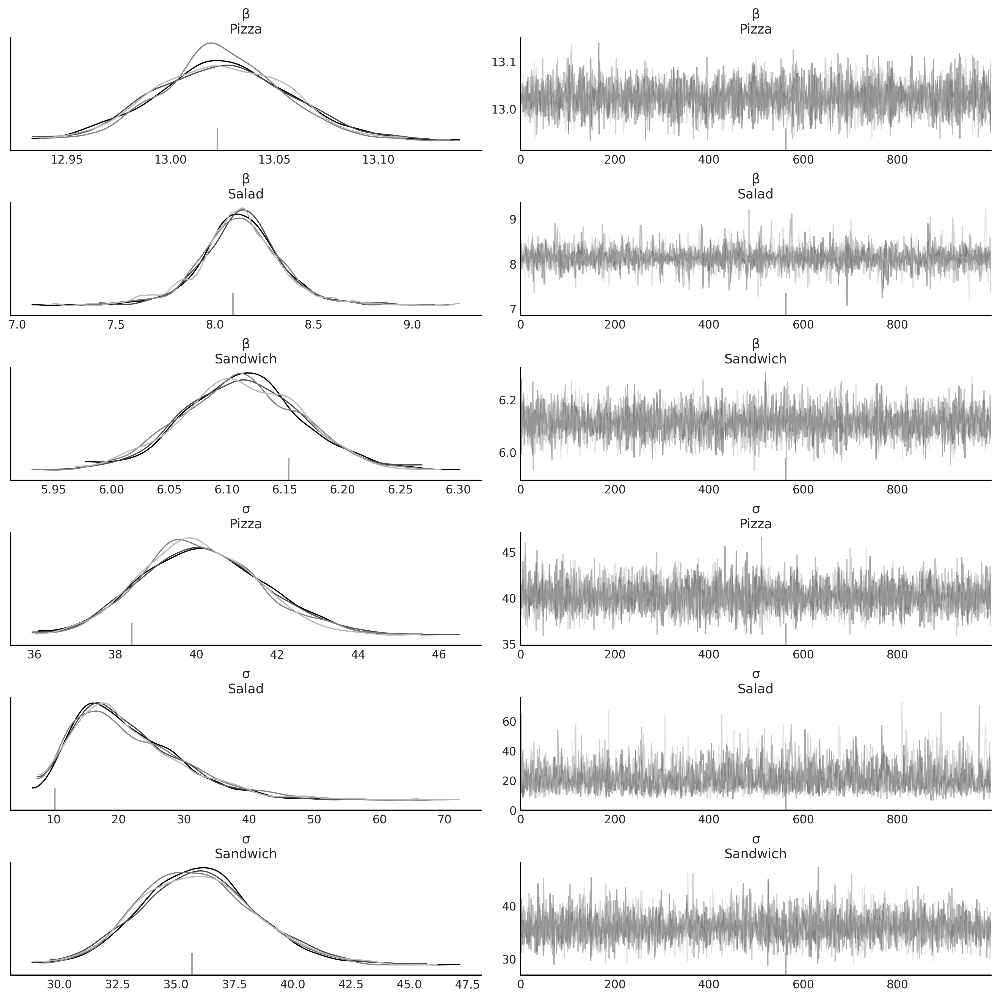

In [40]:
az.plot_trace(idata_sales_unpooled, var_names=["β", "σ"], compact=False);

After sampling from `model_sales_unpooled` we can create forest plots of
the parameter estimates as shown in Figures
{numref}`fig:Salad_Sales_Basic_Regression_ForestPlot_beta` and
{numref}`fig:Salad_Sales_Basic_Regression_ForestPlot_sigma`. Note how
the estimate of $\sigma$ for the salad food category is quite wide
compared to the sandwich and pizza groups. This is what we would expect
from our unpooled model when we have large amounts of data for some of
the categories, but much less for others.

```{figure} figures/Salad_Sales_Basic_Regression_ForestPlot_beta.png
:name: fig:Salad_Sales_Basic_Regression_ForestPlot_beta
:width: 7.00in
Forest plot of the $\beta$ parameter estimates `model_sales_unpooled`.
As expected the estimate of the $\beta$ coefficient for the salads group
is the widest as this group has the least amount of data.
```

```{figure} figures/Salad_Sales_Basic_Regression_ForestPlot_sigma.png
:name: fig:Salad_Sales_Basic_Regression_ForestPlot_sigma
:width: 7.00in
Forest plot of the $\sigma$ parameter estimates `model_sales_unpooled`.
Like {numref}`fig:Salad_Sales_Basic_Regression_ForestPlot_beta` the
estimate of the variation of sales, $\sigma$, is largest for the salads
group as there are not as many data points relative to the pizza and
sandwich groups.
```

The unpooled model is no different than if we have created three
separated models with subsets of the data, exactly as we did in
Section {ref}`comparing_distributions`, where the
parameters of each group were estimated separately so we can consider
the unpooled model architecture syntactic sugar for modeling independent
linear regressions of each group. More importantly now we can use the
unpooled model and the estimated parameters from it as a baseline to
compare other models in the following sections, particularly to
understand if the extra complexity is justified.

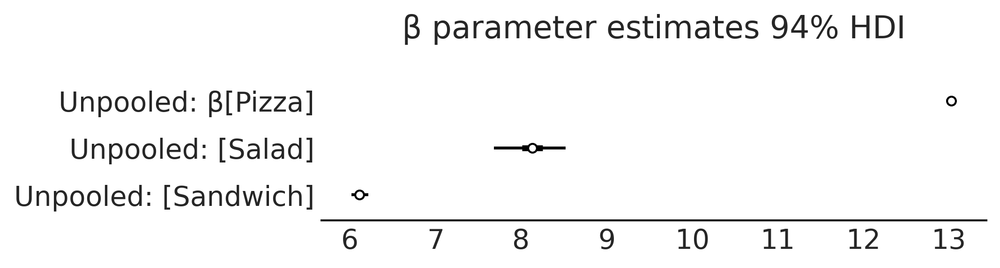

In [41]:
axes = az.plot_forest([idata_sales_unpooled],
                      model_names = ["Unpooled",],
                      var_names=["β"], combined=True, figsize=(7, 1.8));
axes[0].set_title("β parameter estimates 94% HDI")
plt.savefig("img/chp04/salad_sales_basic_regression_forestplot_beta.png")

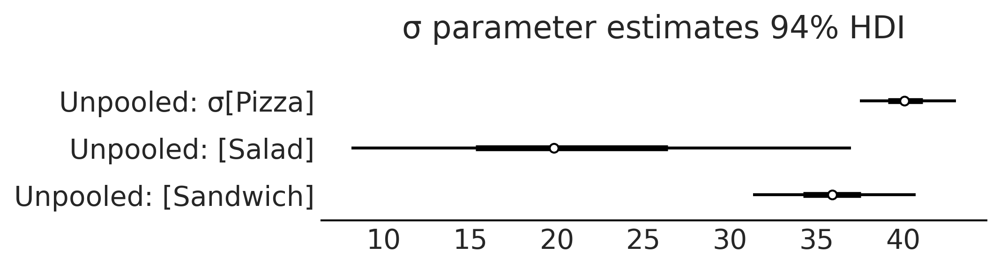

In [42]:
axes = az.plot_forest([idata_sales_unpooled],
                      model_names = ["Unpooled",],
                      var_names=["σ"], combined=True, figsize=(7, 1.8));
axes[0].set_title("σ parameter estimates 94% HDI")
plt.savefig("img/chp04/salad_sales_basic_regression_forestplot_sigma.png")

(pooled-parameters)=

### 4.5.2 Pooled Parameters

If there are unpooled parameters, you might guess there are pooled
parameters and you would be correct. As the name suggests pooled
parameters are ones where the group distinction is ignored.
Conceptually, this type of model is shown in {numref}`fig:pooled_model`
were each group shares the same parameters and thus we also refer to
them as common parameters.

```{figure} figures/pooled_model.png
:name: fig:pooled_model
:width: 5.00in
A pooled model where each group of observations, $y_1, y_2, ..., y_j$
shares parameters.
```

For our restaurant example, the model is written in Equation
{eq}`eq:pooled_regression` and Code Block
[model_sales_pooled](model_sales_pooled). The GraphViz
representation is also shown in
{numref}`fig:Salad_Sales_Basic_Regression_Model_Unpooled`.

```{math} 
:label: eq:pooled_regression
\begin{split}
\beta \sim& \overbrace{\mathcal{N}(\mu_{\beta}, \sigma_{\beta})}^{\text{Common}}\\
\sigma \sim& \overbrace{\mathcal{HN}(\sigma_{\sigma})}^{\text{Common}}\\
\mu =& \beta_{1} X_{1} + \dots + \beta_{m} X_{m} \\
Y \sim& \mathcal{N}(\mu, \sigma)
\end{split}

```

```{code-block} python
:name: model_sales_pooled
:caption: model_sales_pooled

with pm.Model() as model_sales_pooled:
    σ = pm.HalfNormal("σ", 20)
    β = pm.Normal("β", mu=10, sigma=10)

    μ = pm.Deterministic("μ", β * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ,
                      observed=sales_observed)
                        
    inf_data_sales_pooled = pm.sample()
```

```{figure} figures/Salad_Sales_Basic_Regression_Model_Pooled.png
:name: fig:Salad_Sales_Basic_Regression_Model_Pooled
:width: 3.00in
Diagram of `model_sales_pooled`. Unlike
{numref}`fig:Salad_Sales_Basic_Regression_Model_Unpooled` there is only
one instance of $\beta$ and $\sigma$.
```

```{figure} figures/Salad_Sales_Basic_Regression_ForestPlot_Sigma_Comparison.png
:name: fig:Salad_Sales_Basic_Regression_ForestPlot_Sigma_Comparison
:width: 7.00in
A comparison of the estimates of the $\sigma$ parameter from
`model_pooled_sales` and `model_unpooled_sales`. Note how we only get
one estimate of $\sigma$ that is much higher compared to the unpooled
model as the single linear fit estimated must capture the variance in
the pooled data.
```

In [43]:
with pm.Model() as model_sales_pooled:
    σ = pm.HalfNormal("σ", 20)
    β = pm.Normal("β", mu=10, sigma=10)

    μ = pm.Deterministic("μ", β * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ,
                      observed=sales_observed)
                        
    idata_sales_pooled = pm.sample()

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.


In [44]:
with model_sales_pooled:
    idata_sales_pooled.extend(pm.sample_posterior_predictive(idata_sales_pooled))

Sampling: [sales]


Output()

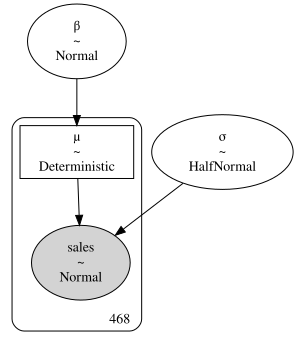

In [45]:
pooled_sales_diagram = pm.model_to_graphviz(model_sales_pooled)
pooled_sales_diagram.render("img/chp04/salad_sales_basic_regression_model_pooled", format="png", cleanup=True)
pooled_sales_diagram

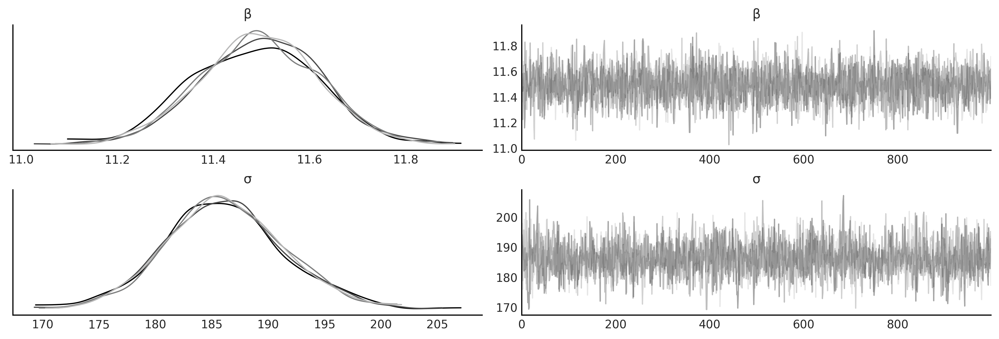

In [46]:
az.plot_trace(idata_sales_pooled, var_names=["β", "σ"], compact=False);

In [47]:
az.summary(idata_sales_pooled, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β,11.493,0.125,11.274,11.737,0.002,0.001,3715.0,2907.0,1.0
σ,186.175,5.316,175.943,196.203,0.089,0.063,3596.0,2638.0,1.0


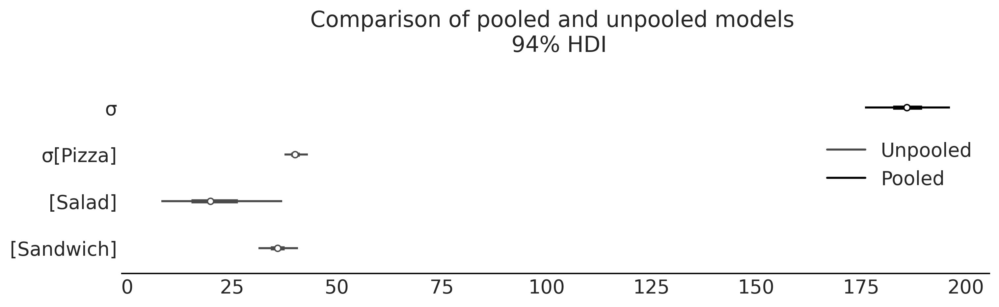

In [48]:
axes = az.plot_forest([idata_sales_pooled, idata_sales_unpooled],
                      model_names = ["Pooled", "Unpooled"], var_names=["σ"], combined=True, figsize=(10, 3));
axes[0].set_title("Comparison of pooled and unpooled models \n 94% HDI")

#plt.subplots_adjust(top=1)
plt.savefig("img/chp04/salad_sales_basic_regression_forestplot_sigma_comparison.png", bbox_inches='tight')

The benefit of the pooled approach is that more data will be used to
estimate each parameter. However, this means we cannot understand each
group individually, just all food categories as a whole. Looking at
{numref}`fig:Salad_Sales_Basic_Regression_Scatter_Pooled`, our estimates
$\beta$ and $\sigma$ are not indicative of any particular food group as
the model is grouping together data with very different scales. Compare
the value of $\sigma$ with the ones from the unpooled model in
{numref}`fig:Salad_Sales_Basic_Regression_ForestPlot_Sigma_Comparison`.
When plotting the regression in
{numref}`fig:Salad_Sales_Basic_Regression_Scatter_Pooled` we can see
that a single line, despite being informed by more data than any single
group, fails to fit any one group well. This result implies that the
differences in the groups are too large to ignore and thus pooling the
data it is not particularly useful for our intended purpose.

```{figure} figures/Salad_Sales_Basic_Regression_Scatter_Pooled.png
:name: fig:Salad_Sales_Basic_Regression_Scatter_Pooled
:width: 7.00in
Linear regression `model_sales_pooled` where all the data is pooled
together. Each of the parameters is estimated using all the data but we
end up with poor estimates of each individual group's behavior as a 2
parameter model cannot generalize well enough to capture the nuances of
each group.
```

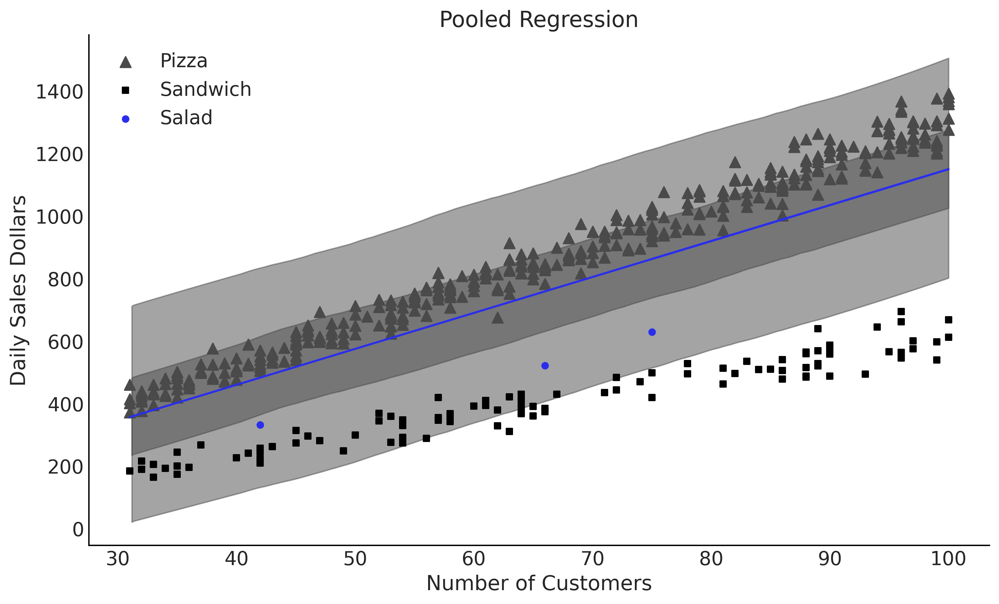

In [49]:
fig, ax = plt.subplots(figsize=(10, 6))
μ_m = idata_sales_pooled.posterior["μ"].mean(("chain", "draw"))
#σ_m = idata_sales_pooled.posterior["σ"].mean(("chain", "draw"))

ax.plot(customers, μ_m, c='C4')

az.plot_hdi(customers, idata_sales_pooled.posterior_predictive["sales"], hdi_prob=.50, ax=ax)
az.plot_hdi(customers, idata_sales_pooled.posterior_predictive["sales"], hdi_prob=.94, ax=ax)


pizza_df.plot(x="customers", y="sales", kind="scatter", ax=ax, c="C1", label="Pizza", marker="^", s=60);
sandwich_df.plot(x="customers", y="sales", kind="scatter", ax=ax,  label="Sandwich", marker="s");
salad_df.plot(x="customers", y="sales", kind="scatter", ax=ax, label="Salad", c="C4");


ax.set_xlabel("Number of Customers")
ax.set_ylabel("Daily Sales Dollars")
ax.set_title("Pooled Regression")
plt.savefig("img/chp04/salad_sales_basic_regression_scatter_pooled.png")

### 4.5.3 Mixing Group and Common Parameters

In the unpooled approach we get the benefit of preserving the
differences in our groups, and thus getting an estimated set of
parameters for each group. In the pooled approach we get the benefit of
utilizing all the data to estimate a single set of parameters, and thus
more informed, albeit more generic, estimates. Fortunately we are not
forced to pick just one option or the other. We can mix these two
concepts in a single model shown in Equation
{eq}`eq:multilevel_regression`. In this formulation we have decided to
keep the estimate of $\beta$ group specific, or unpooled, and to use a
common, or pooled, $\sigma$. In our current example we do not have an
intercept, but in a regression that included an intercept term we would
have a similar choice, pool all the data into a single estimate, or
leave the data separated in groups for an estimate per group.

```{math} 
:label: eq:multilevel_regression
\begin{split}
\beta_{mj} \sim& \overbrace{\mathcal{N}(\mu_{\beta m}, \sigma_{\beta m})}^{\text{Group-specific}}\\
\sigma \sim& \overbrace{\mathcal{HN}(\sigma_{\sigma})}^{\text{Common}}\\
\mu_{j} =& \beta_{1j} X_{1} + \dots + \beta_{m} X_{m} \\
Y \sim& \mathcal{N}(\mu_{j}, \sigma)
\end{split}

```

::: {admonition} Random and fixed effects and why you should forget these terms

The parameters that are specific to each level and those that are common
across levels get different names, including random or varying effect,
or fixed or constant effect, respectively. To add to the confusion
different people may assign different meanings to these terms especially
when talking about fixed and random effects {cite:p}`gelman2005`. If we have to
label these terms we suggest *common* and *group-specific*
{cite:p}`gabry_goodrich_2020, capretto2020`. However, as all these different
terms are widely used we recommend that you always verify the details of
the model so to avoid confusions and misunderstandings.
:::

To reiterate in our sales model we are interested in pooling the data to
estimate $\sigma$ as we believe there could be identical variance of the
sales of pizza, sandwiches, and salads, but we leave our estimate of
$\beta$ unpooled, or independent, as we know there are differences
between the groups. With these ideas we can write our PyMC3 model as
shown in Code Block
[model_sales_mixed_effect](model_sales_mixed_effect), as
well as generate a graphical diagram of the model structure shown in
{numref}`fig:Salad_Sales_Basic_Regression_Model_Multilevel`. From the
model we can plot
{numref}`fig:Salad_Sales_Basic_Regression_Scatter_Sigma_Pooled_Slope_Unpooled`
showing the estimate of fit overlaid on the data, as well as a
comparison of the $\sigma$ parameter estimates from the multilevel and
unpooled models in
{numref}`fig:Salad_Sales_ForestPlot_Sigma_Unpooled_Multilevel_Comparison`.
These results are encouraging, for all three categories the fits looks
reasonable and for the salad group in particular it seems this model
will be able to produce plausible inferences about salad sales in this
new market.


```{code-block} python
:name: model_sales_mixed_effect
:caption: model_sales_mixed_effect

with pm.Model() as model_pooled_sigma_sales:
    σ = pm.HalfNormal("σ", 20)
    β = pm.Normal("β", mu=10, sigma=20, shape=3)
    
    μ = pm.Deterministic("μ", β[food_category.codes] * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ, observed=sales_observed)
    
    trace_pooled_sigma_sales = pm.sample()
    ppc_pooled_sigma_sales = pm.sample_posterior_predictive(
        trace_pooled_sigma_sales)

    inf_data_pooled_sigma_sales = az.from_pymc3(
        trace=trace_pooled_sigma_sales,
        posterior_predictive=ppc_pooled_sigma_sales,
        coords={"β_dim_0":food_category.categories})
```

```{figure} figures/Salad_Sales_Basic_Regression_Model_Multilevel.png
:name: fig:Salad_Sales_Basic_Regression_Model_Multilevel
:width: 3.00in
`model_pooled_sigma_sales` where $\beta$ is unpooled, as indicated by
the box with 3 in the right corner, and $\sigma$ is pooled, as the lack
of number indicates a single parameter estimate for all groups.
[fig:Salad_Sales_Basic_Regression_Model_Multilevel]{#fig:Salad_Sales_Basic_Regression_Model_Multilevel
label="fig:Salad_Sales_Basic_Regression_Model_Multilevel"}
```

```{figure} figures/Salad_Sales_Basic_Regression_Scatter_Sigma_Pooled_Slope_Unpooled.png
:name: fig:Salad_Sales_Basic_Regression_Scatter_Sigma_Pooled_Slope_Unpooled
:width: 7.00in
Linear model with 50% HDI from `model_pooled_sigma_sales`. This model is
more useful for our purposes of estimating salad sales as the slopes are
independently estimated for each group. Note how all the data is being
used to estimate the single posterior distribution of $\sigma$.
[fig:Salad_Sales_Basic_Regression_Scatter_Sigma_Pooled_Slope_Unpooled]{#fig:Salad_Sales_Basic_Regression_Scatter_Sigma_Pooled_Slope_Unpooled
label="fig:Salad_Sales_Basic_Regression_Scatter_Sigma_Pooled_Slope_Unpooled"}
```

```{figure} figures/Salad_Sales_ForestPlot_Sigma_Unpooled_Multilevel_Comparison.png
:name: fig:Salad_Sales_ForestPlot_Sigma_Unpooled_Multilevel_Comparison
:width: 7.00in
Comparison of $\sigma$ from `model_pooled_sigma_sales` and
`model_pooled_sales`. Note how the estimated of $\sigma$ in the
multilevel model is within the bounds of the $\sigma$ estimates from the
pooled model.
[fig:Salad_Sales_ForestPlot_Sigma_Unpooled_Multilevel_Comparison]{#fig:Salad_Sales_ForestPlot_Sigma_Unpooled_Multilevel_Comparison
label="fig:Salad_Sales_ForestPlot_Sigma_Unpooled_Multilevel_Comparison"}
```

In [50]:
coords = {"meals":food_category.categories, "meals_idx":food_category}

with pm.Model(coords=coords) as model_pooled_sigma_sales:
    σ = pm.HalfNormal("σ", 20)
    β = pm.Normal("β", mu=10, sigma=20, dims="meals")
    
    μ = pm.Deterministic("μ", β[food_category.codes] * customers, dims="meals_idx")
    
    sales = pm.Normal("sales", mu=μ, sigma=σ, observed=sales_observed, dims="meals_idx")
    
    idata_pooled_sigma_sales = pm.sample()
    idata_pooled_sigma_sales.extend(pm.sample_posterior_predictive(idata_pooled_sigma_sales))

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ, β]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1 seconds.
Sampling: [sales]


Output()

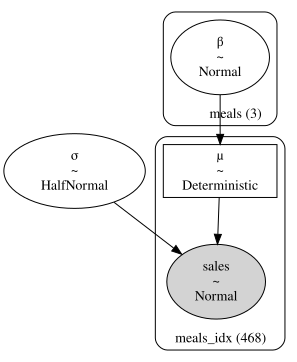

In [51]:
multilevel_sales_diagram = pm.model_to_graphviz(model_pooled_sigma_sales)
multilevel_sales_diagram.render("img/chp04/salad_sales_basic_regression_model_multilevel", format="png", cleanup=True)
multilevel_sales_diagram

In [52]:
az.summary(idata_pooled_sigma_sales, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β[Pizza],13.024,0.029,12.969,13.079,0.000,0.000,4803.0,2999.0,1.0
β[Salad],8.126,0.369,7.448,8.832,0.004,0.003,6823.0,3335.0,1.0
β[Sandwich],6.111,0.055,6.006,6.210,0.001,0.000,6168.0,3474.0,1.0
σ,39.231,1.270,36.935,41.676,0.017,0.012,5832.0,2840.0,1.0


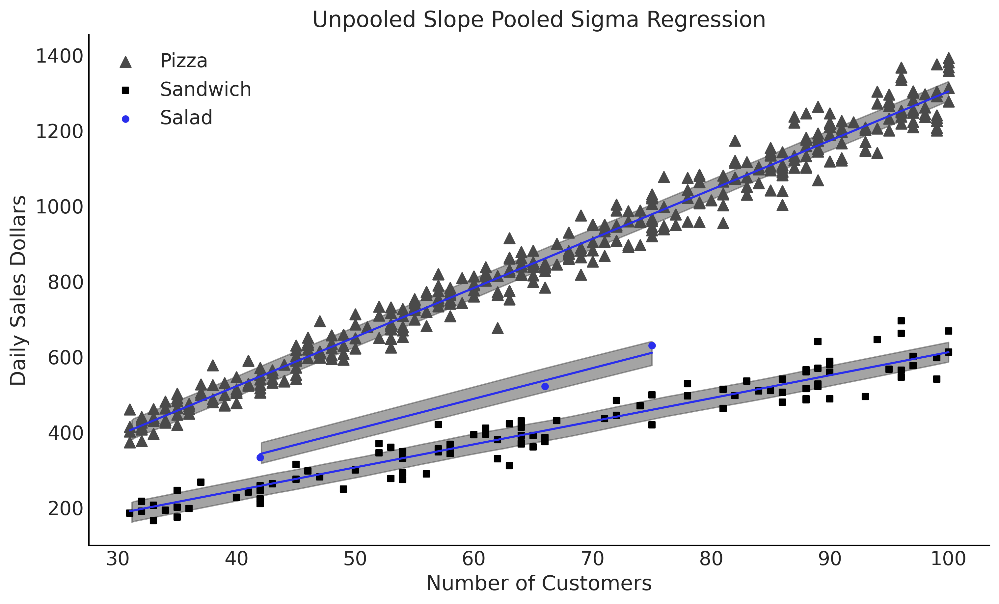

In [53]:
fig, ax = plt.subplots(figsize=(10, 6))
σ_m = idata_sales_pooled.posterior["σ"].mean().values

# Salads

for meal in food_category.categories:
    category_mask = (food_category==meal)
    μ_m_meals = idata_pooled_sigma_sales.posterior["μ"].sel({"meals_idx":meal})
    ax.plot(sales_df.customers[category_mask], μ_m_meals.mean(("chain", "draw")), c='C4')
    az.plot_hdi(sales_df.customers[category_mask], 
                idata_pooled_sigma_sales.posterior_predictive["sales"].sel({"meals_idx":meal}),
                hdi_prob=.50, ax=ax, fill_kwargs={"alpha": .5})


pizza_df.plot(x="customers", y="sales", kind="scatter", ax=ax, c="C1", label="Pizza", marker="^", s=60);
sandwich_df.plot(x="customers", y="sales", kind="scatter", ax=ax,  label="Sandwich", marker="s");
salad_df.plot(x="customers", y="sales", kind="scatter", ax=ax, label="Salad", c="C4");


ax.set_xlabel("Number of Customers")
ax.set_ylabel("Daily Sales Dollars")
ax.set_title("Unpooled Slope Pooled Sigma Regression")
plt.savefig("img/chp04/salad_sales_basic_regression_scatter_sigma_pooled_slope_unpooled.png")

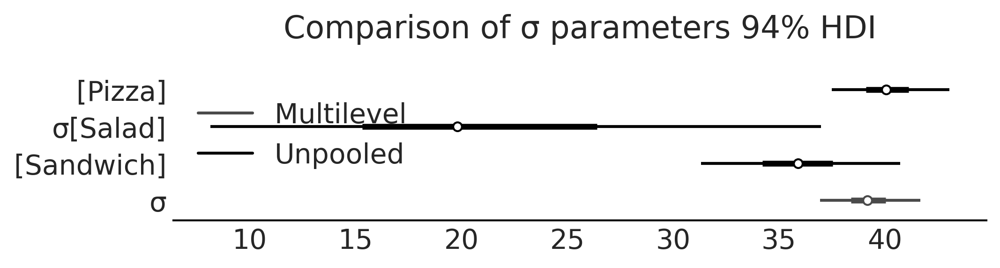

In [54]:
axes = az.plot_forest([idata_sales_unpooled,
                       idata_pooled_sigma_sales
                      ],
                      model_names = ["Unpooled",
                                     "Multilevel "
                                    ],
                      var_names=["σ"], combined=True, figsize=(7, 1.8));
axes[0].set_title("Comparison of σ parameters 94% HDI")

plt.savefig("img/chp04/salad_sales_forestplot_sigma_unpooled_multilevel_comparison.png")

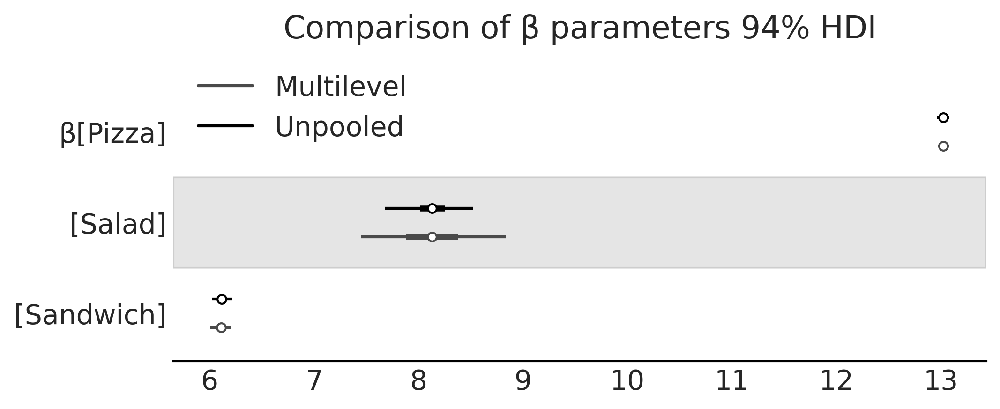

In [55]:
axes = az.plot_forest([idata_sales_unpooled,
                       idata_pooled_sigma_sales
                      ],
                      model_names = ["Unpooled",
                                     "Multilevel"
                                    ],
                      var_names=["β"], combined=True, figsize=(7, 2.8));
axes[0].set_title("Comparison of β parameters 94% HDI");

(hierarchical-models)=

## 4.6 Hierarchical Models

In our data treatment thus far we have had two options for groups,
pooled where there is no distinction between groups, and unpooled where
there a complete distinction between groups. Recall though in our
motivating restaurant example we believed the parameter $\sigma$ of the
3 food categories to be similar, but not exactly the same. In Bayesian
modeling we can express this idea with *hierarchical models*. In
hierarchical models the parameters are *partially pooled*. The partial
refers to the idea that groups that do not share one fixed parameter,
but share a *hyperprior distribution* which describes the distribution of the parameters of
the prior itself. Conceptually this idea is shown in
{numref}`fig:partial_pooled_model`. Each group gets its own parameters
which are drawn from a common hyperprior distribution.

```{figure} figures/partial_pooled_model.png
:name: fig:partial_pooled_model
:width: 5.00in
A partially pooled model architecture where each group of observations,
$y_1, y_2, ..., y_k$ has its own set of parameters, but they are not
independent as they are drawn from a common distribution.
```

Using statistical notation we can write a hierarchical model in Equation
{eq}`eq:hierarchical_regression`, the computational model in Code Block
[model_hierarchical_sales](model_hierarchical_sales), and
a graphical representation in
{numref}`fig:Salad_Sales_Hierarchial_Regression_Model`.

```{math} 
:label: eq:hierarchical_regression

\begin{split}
\beta_{mj} \sim& \mathcal{N}(\mu_{\beta m}, \sigma_{\beta m}) \\
\sigma_{h} \sim& \overbrace{\mathcal{HN}(\sigma)}^{\text{Hyperprior}} \\
\sigma_{j} \sim& \overbrace{\mathcal{HN}(\sigma_{h})}^{\substack{\text{Group-specific} \\ \text{pooled}}} \\
\mu_{j} =& \beta_{1j} X_1 + \dots + \beta_{mj} X_m \\
Y \sim& \mathcal{N}(\mu_{j},\sigma_{j})
\end{split}
```

Note the addition of $\sigma_{h}$ when compared to the multilevel model
in {numref}`fig:Salad_Sales_Basic_Regression_Model_Multilevel`. This is
our new hyperprior distributions that defines the possible parameters of
individual groups. We can add the hyperprior in Code Block
[model_hierarchical_sales](model_hierarchical_sales) as
well. You may ask "could we have added a hyperprior for the $\beta$
terms as well?\", and the answer is quite simply yes we could have. But
in this case we assume that only the variance is related, which
justifying the use of partial pooling and that the slopes are completely
independent. Because this is a simulated textbook example we can plainly
make this statement and "get away with it\", in a real life scenario
more domain expertise and model comparison would be advised to justify
this claim.

```{code-block} python
:name: model_hierarchical_sales
:caption: model_hierarchical_sales


with pm.Model() as model_hierarchical_sales:
    σ_hyperprior = pm.HalfNormal("σ_hyperprior", 20)
    σ = pm.HalfNormal("σ", σ_hyperprior, shape=3)
    
    β = pm.Normal("β", mu=10, sigma=20, shape=3)
    μ = pm.Deterministic("μ", β[food_category.codes] * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ[food_category.codes],
                      observed=sales_observed)
    
    trace_hierarchical_sales = pm.sample(target_accept=.9)
    
    inf_data_hierarchical_sales = az.from_pymc3(
        trace=trace_hierarchical_sales, 
        coords={"β_dim_0":food_category.categories,
                "σ_dim_0":food_category.categories})
```

```{figure} figures/Salad_Sales_Hierarchial_Regression_Model.png
:name: fig:Salad_Sales_Hierarchial_Regression_Model
:width: 3.00in
`model_hierarchical_sales` where $\sigma_{hyperprior}$ is the single
hierarchical distribution for the three $\sigma$ distributions.
```

```{figure} figures/Salad_Sales_ForestPlot_Sigma_Hierarchical.png
:name: fig:Salad_Sales_ForestPlot_Sigma_Hierarchical
:width: 7.00in
Forest plot of the $\sigma$ parameter estimates for
`model_hierarchical_sales`. Note how the hyperprior tends to represent
fall within the range of the three group priors.
```    

In [56]:
with pm.Model(coords=coords) as model_hierarchical_sales:
    σ_hyperprior = pm.HalfNormal("σ_hyperprior", 20)
    σ = pm.HalfNormal("σ", σ_hyperprior,  dims="meals")
    
    β = pm.Normal("β", mu=10, sigma=20, dims="meals")
    μ = pm.Deterministic("μ", β[food_category.codes] * customers)
    
    sales = pm.Normal("sales", mu=μ, sigma=σ[food_category.codes],
                      observed=sales_observed)
    
    idata_hierarchical_sales = pm.sample(target_accept=.9)

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [σ_hyperprior, σ, β]


Output()

Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 2 seconds.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.


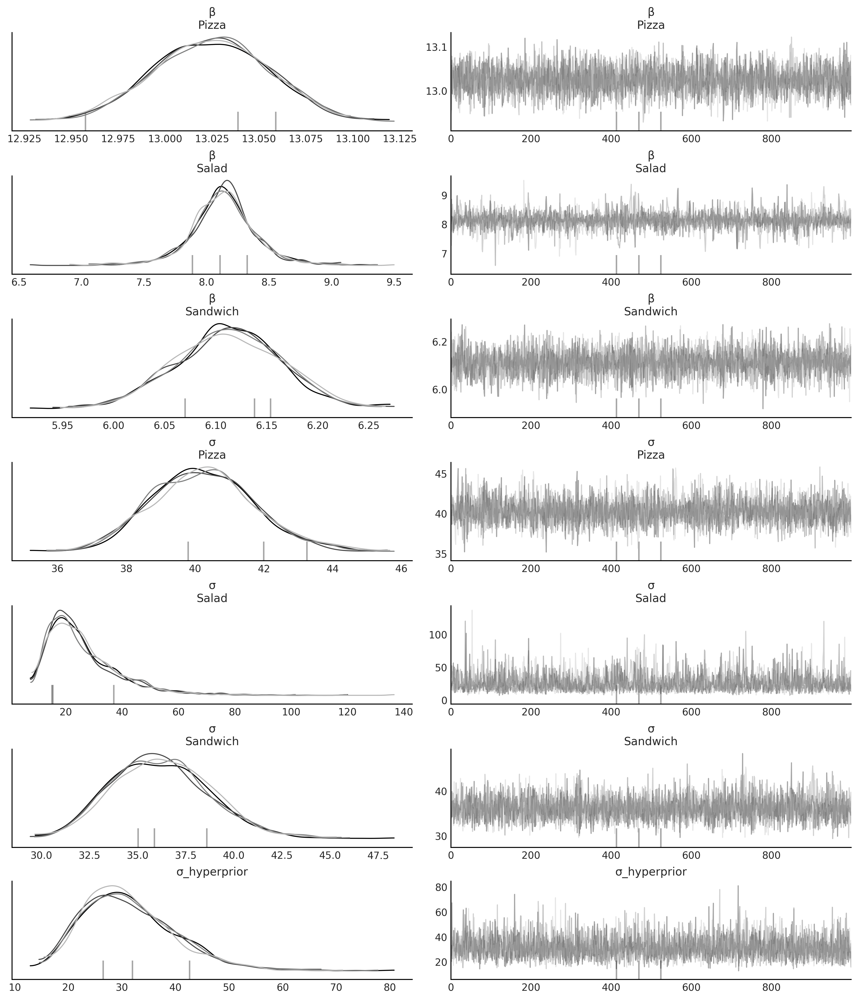

In [57]:
az.plot_trace(idata_hierarchical_sales, compact=False, var_names=["β", "σ", "σ_hyperprior"]);

<Axes: >

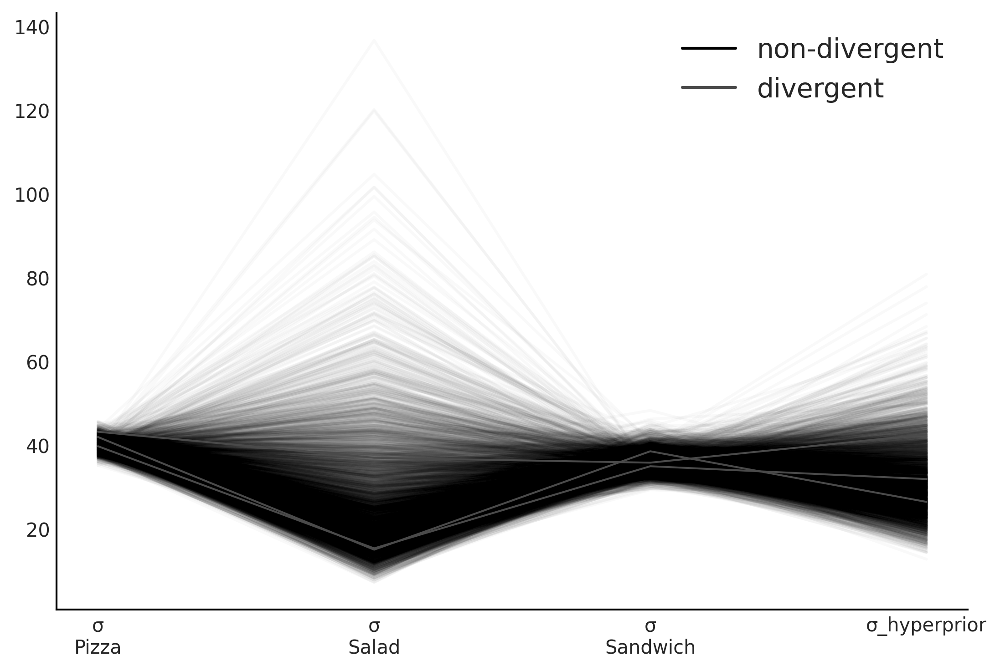

In [58]:
az.plot_parallel(idata_hierarchical_sales, var_names=["σ", "σ_hyperprior"])

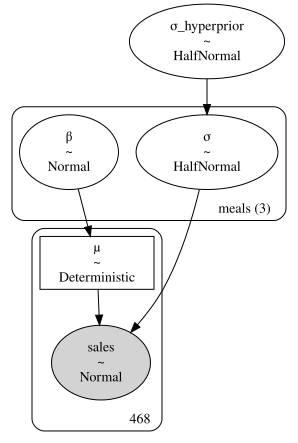

In [59]:
hierarchial_sales_diagram = pm.model_to_graphviz(model_hierarchical_sales)
hierarchial_sales_diagram.render("img/chp04/salad_sales_hierarchial_regression_model", format="png", cleanup=True)
hierarchial_sales_diagram

In [60]:
az.summary(idata_hierarchical_sales, var_names=["β", "σ"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
β[Pizza],13.025,0.031,12.966,13.079,0.000,0.000,5137.0,2757.0,1.0
β[Salad],8.133,0.270,7.593,8.651,0.005,0.004,3295.0,2086.0,1.0
β[Sandwich],6.113,0.052,6.018,6.211,0.001,0.001,5264.0,2958.0,1.0
σ[Pizza],40.251,1.520,37.379,43.076,0.022,0.016,4718.0,2478.0,1.0
σ[Salad],26.042,13.195,8.297,49.169,0.254,0.180,3048.0,2935.0,1.0
σ[Sandwich],36.209,2.539,31.798,40.992,0.034,0.025,5693.0,2573.0,1.0


Text(0.5, 1.0, 'Hierarchical β estimates 94% HDI')

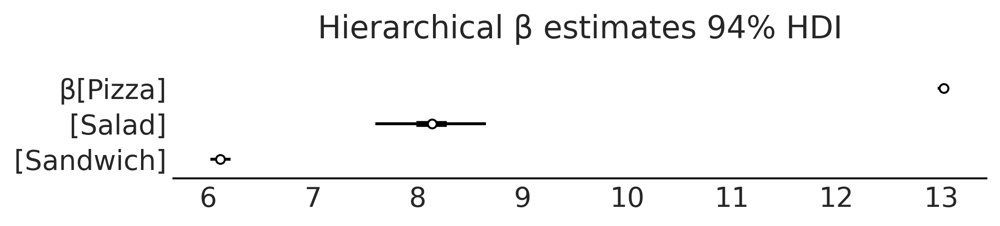

In [61]:
axes = az.plot_forest(idata_hierarchical_sales, var_names=["β"], combined=True,  figsize=(7, 1.5))
axes[0].set_title("Hierarchical β estimates 94% HDI")

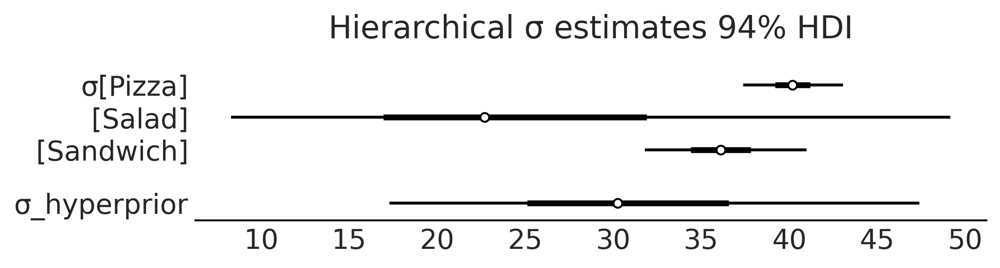

In [62]:
axes = az.plot_forest(idata_hierarchical_sales, var_names=["σ", "σ_hyperprior"], combined=True,  figsize=(7, 1.8))
axes[0].set_title("Hierarchical σ estimates 94% HDI")
plt.savefig("img/chp04/salad_sales_forestplot_sigma_hierarchical.png")


In [63]:
print(food_category.categories)

Index(['Pizza', 'Salad', 'Sandwich'], dtype='object')


After fitting the hierarchical model we can inspect the $\sigma$
parameter estimates in
{numref}`fig:Salad_Sales_ForestPlot_Sigma_Hierarchical`. Again note the
addition of $\sigma_{hyperprior}$ which is a distribution that estimates
the distribution of the parameters for each of the three food
categories. We can also see the effect of a hierarchical model if we
compare the summary tables of the unpooled model and hierarchical models
in {numref}`tab:unpooled_sales`. In the unpooled estimate the mean of
the $\sigma$ estimate for salads is 21.3, whereas in the hierarchical
estimate the mean of the same parameter estimate is now 25.5, and has
been "pulled\" up by the means of the pizza and sandwiches category.
Moreover, the estimates of the pizza and sandwich categories in the
hierarchical category, while regressed towards the mean slightly, remain
largely the same as the unpooled estimates. Note how the estimates of each
sigma are distinctly different from each other. Given that our observed data
and the model which does not share information between groups this consistent
with our expectations.



```{list-table} Estimates of σ for each category from the unpooled sales model
:name: tab:unpooled_sales
* -
  - **mean**
  - **sd**
  - **hdi_3%**
  - **hdi_97%**
* - $\sigma$Pizza
  - 40.1
  -  1.5
  - 37.4
  - 42.8
* - $\sigma$Salad
  - 21.3
  -  8.3
  -  8.8
  - 36.8
* - $\sigma$Sandwich
  - 35.9
  -  2.5
  - 31.6
  - 40.8
```


```{list-table} Estimates of σ for each category from the hierarchical sales model
:name: tab:Hierarchical_sales
* -
  - **mean**
  - **sd**
  - **hdi_3%**
  - **hdi_97%**
* - $\sigma$Pizza
  - 40.3
  -  1.5
  - 37.5
  - 43.0
* - $\sigma$Salad
  - 25.5
  - 12.4
  -  8.4
  - 48.7
* - $\sigma$Sandwich
  - 36.2
  -  2.6
  - 31.4
  - 41.0
* - $\sigma_{hyperprior}$
  - 31.2
  -  8.7
  - 15.8
  - 46.9
```

In [64]:
az.summary(idata_sales_unpooled.posterior["σ"], kind="stats").round(1)

,mean,sd,hdi_3%,hdi_97%
σ[Pizza],40.1,1.5,37.5,43.1
σ[Salad],21.6,8.6,8.1,37.0
σ[Sandwich],36.0,2.5,31.3,40.7


In [65]:
az.summary(idata_hierarchical_sales, var_names=["σ", "σ_hyperprior"], kind="stats").round(1)

,mean,sd,hdi_3%,hdi_97%
σ[Pizza],40.3,1.5,37.4,43.1
σ[Salad],26.0,13.2,8.3,49.2
σ[Sandwich],36.2,2.5,31.8,41.0
σ_hyperprior,31.4,8.7,17.3,47.4


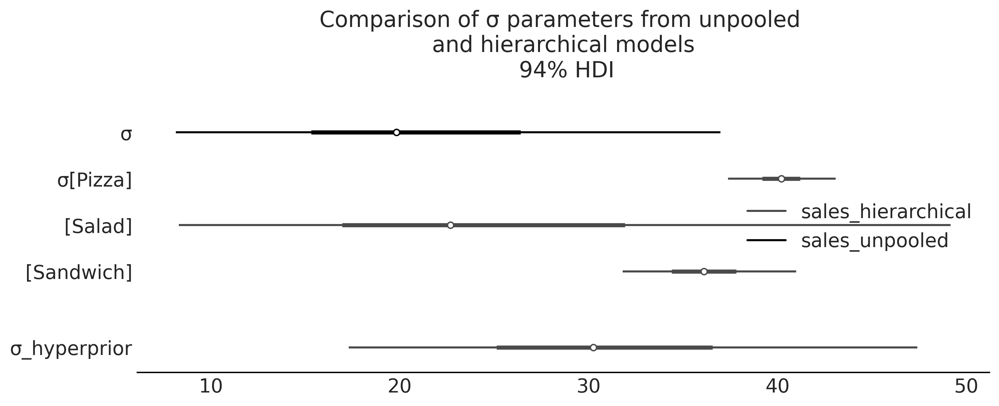

In [66]:
axes = az.plot_forest([idata_sales_unpooled.posterior["σ"].sel({"meals":"Salad"}),
                       idata_hierarchical_sales
                      ],
                      model_names = ["sales_unpooled",
                                     "sales_hierarchical"
                                    ], combined=True, figsize=(10, 4),
                     var_names=["σ", "σ_hyperprior"]
                     );
axes[0].set_title("Comparison of σ parameters from unpooled \n and hierarchical models \n 94% HDI")

plt.savefig("img/chp04/salad_sales_forestolot_sigma_unpooled_multilevel_comparison.png")

Text(0.5, 1.0, 'Comparison of Hierarchical versus Unpooled Variance')

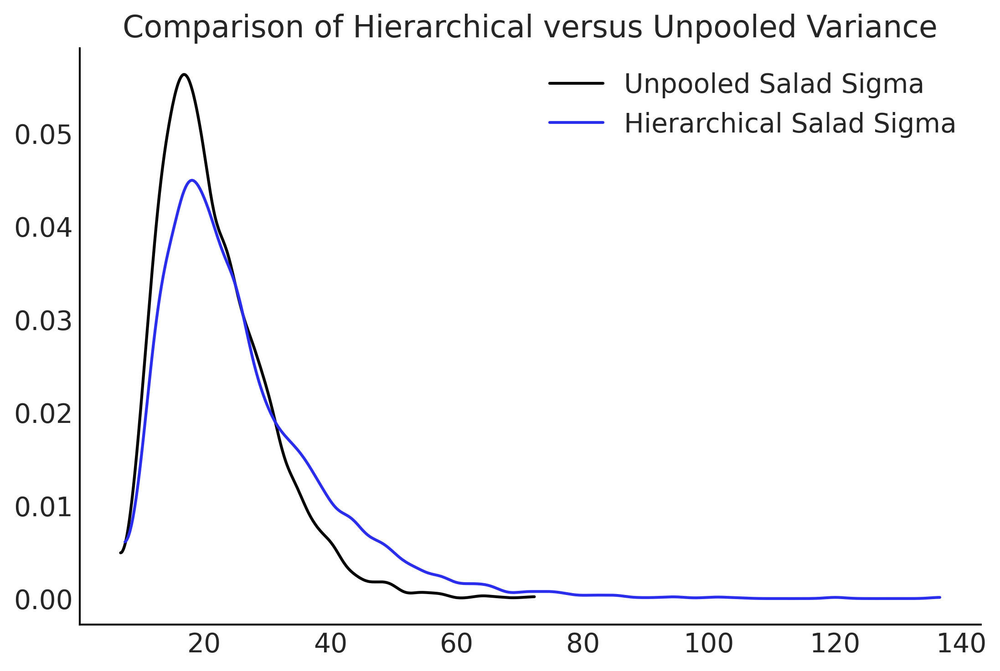

In [67]:
fig, ax = plt.subplots()
az.plot_kde(idata_sales_unpooled.posterior['σ'].sel({"meals":"Salad"}).values, 
            label="Unpooled Salad Sigma", ax=ax)
az.plot_kde(idata_hierarchical_sales.posterior["σ"].sel({"meals":"Salad"}).values, 
            label="Hierarchical Salad Sigma", plot_kwargs={"color":"C4"}, ax=ax)

ax.set_title("Comparison of Hierarchical versus Unpooled Variance")

::: {admonition} I heard you like hyperpriors so I put a hyperpriors on top of your hyperpriors

In Code Block [model_hierarchical_salad_sales_centered](model_hierarchical_salad_sales_centered)
we placed hyperprior on group level parameter $\sigma_j$. Similarly, we
can extend the model by also adding hyperprior to parameter
$\beta_{mj}$. Note that since $\beta_{mj}$ has a Gaussian distributed
prior, we can actually choose two hyperprior - one for each
hyperparameter. A natural question you might ask is can we go even
further and adding hyperhyperprior to the parameters that are
parameterized the hyperprior? What about hyperhyperhyperprior? While it
is certainly possible to write down such models and sample from it, it
is worth to take a step back and think about what hyperpriors are doing.
Intuitively, they are a way for the model to "borrow" information from
sub-group or sub-cluster of data to inform the estimation of other
sub-group/cluster with less observation. The group with more
observations will inform the posterior of the hyperparameter, which then
in turn regulates the parameters for the group with less observations.
In this lens, putting hyperprior on parameters that are not group
specific is quite meaningless.
:::

Hierarchical estimates are not just limited to two levels. For example,
the restaurant sales model could be extended into a three-level
hierarchical model where the top level represented the company level,
the next level represented the geographical market (New York, Chicago,
Los Angeles), and the lowest level represented an individual location.
By doing so we can have a hyperprior characterizing how the whole
company was doing, hyperpriors indicating how a region was doing, and
priors on how each store was doing. This allows easy comparisons in mean
and variation, and expands the application in many different ways based
on a single model.

(model_geometry)=

### 4.6.1 Posterior Geometry Matters

So far we have largely focused on the structure and math behind the
model, and assumed our sampler would be able to provide us an
"accurate\" estimate of the posterior. And for relatively simple models
this is largely true, the newest versions of Universal Inference Engines
mostly "just work\", but an important point is that they do not *always*
work. Certain posterior geometries are challenging for samplers, a
common example is Neal's Funnel{cite:p}`neal_2003` shown in
{numref}`fig:Neals_Funnel`. As the name funnel connotes, the shape at
one end is quite wide, before narrowing into a small neck. Recalling Section
{ref}`sampling_methods_intro` samplers function
by taking steps from one set of parameter values to another, and a key
setting is how big of a step to take when exploring the posterior
surface. In complex geometries, such as with Neal's funnel, a step size
that works well in one area, fails miserably in another.

```{figure} figures/Neals_Funnel.png
:name: fig:Neals_Funnel
:width: 7.00in
Correlated samples in a particular shape referred to as Neal's Funnel.
At sampling at the top of the funnel where Y is around a value 6 to 8, a
sampler can take wide steps of lets say 1 unit, and likely remain within
a dense region of the posterior. However, if sampling near the bottom of
the funnel where Y is around a value -6 to -8, a 1 unit step in almost
any direction will likely result in step into a low-density region. This
drastic difference in the posterior geometry shape is one reason poor
posterior estimation, can occur for sampling based estimates. For HMC
samplers the occurence of divergences can help diagnose these sampling
issues.
```

Text(0, 0.5, 'y')

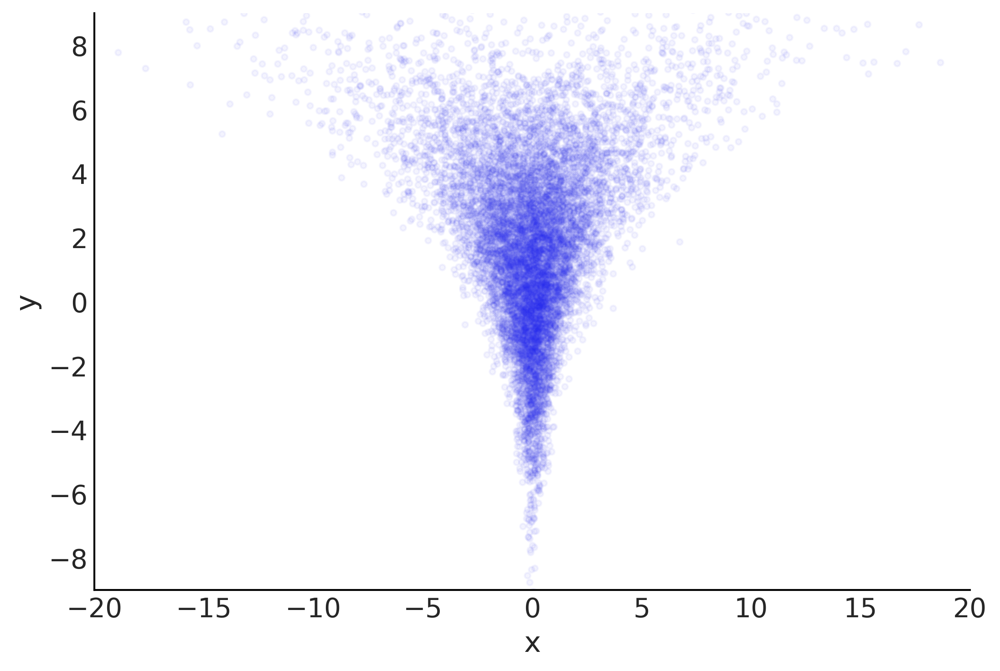

In [68]:
nsample = 10000
nd=1
yr = stats.norm.rvs(loc=2., scale=3., size=nsample)
xnr = stats.norm.rvs(loc=0., scale=np.exp(yr/4), size=(nd, nsample))

fig, ax = plt.subplots()
ax.scatter(xnr[0], yr, marker='.', alpha=.05, color="C4")
ax.set_xlim(-20, 20)
ax.set_ylim(-9, 9)
ax.set_xlabel('x')
ax.set_ylabel('y')

In [69]:
def salad_generator(hyperprior_beta_mean=5, hyperprior_beta_sigma=.2, sigma=50, days_per_location=[6, 4, 15, 10, 3, 5], sigma_per_location=[50,10,20,80,30,20]):
    """Generate noisy salad data"""
    beta_hyperprior = stats.norm(hyperprior_beta_mean, hyperprior_beta_sigma)
    
    # Generate demands days per restaurant
    df = pd.DataFrame()
    for i, days in enumerate(days_per_location):
        np.random.seed(0)

        num_customers = stats.randint(30, 100).rvs(days)
        sales_location = beta_hyperprior.rvs()*num_customers + stats.norm(0, sigma_per_location[i]).rvs(num_customers.shape)

        location_df = pd.DataFrame({"customers":num_customers, "sales":sales_location})
        location_df["location"] = i
        location_df.sort_values(by="customers", ascending=True)
        df = pd.concat([df, location_df])
        
    df.reset_index(inplace=True, drop=True)
    return df
hierarchical_salad_df = salad_generator()

In hierarchical models the geometry is largely defined by the
correlation of hyperpriors to other parameters, which can result in
funnel geometry that are difficult to sample. Unfortunately this is not
only a theoretical problem, but a practical one, that can sneak up
relatively quickly on an unsuspecting Bayesian modeler. Luckily, there
is a relatively easy tweak to models, referred to as a non-centered
parameterization, that helps alleviate the issue.

Continuing with our salad example, let us say we open 6 salad
restaurants and like before are interested in predicting the sales as a
function of the number of customers. The synthetic dataset has been
generated in Python and is shown in
{numref}`fig:Multiple_Salad_Sales_Scatter`. Since the restaurants are
selling the exact same product a hierarchical model is appropriate to
share information across groups. We write the centered model
mathematically in Equation {eq}`eq:centered_hierarchical_regression` and
also Code Block
[model_hierarchical_salad_sales](model_hierarchical_salad_sales).
We will be using TFP and `tfd.JointDistributionCoroutine` in the rest of
the chapter, which more easily highlights the change in
parameterization. This model follows the standard hierarchical format,
where a hyperprior partially pools the parameters of the slope
$\beta_m$.

```{math} 
:label: eq:centered_hierarchical_regression
\begin{split}
\beta_{\mu h} \sim& \mathcal{N} \\
\beta_{\sigma h} \sim& \mathcal{HN} \\
\beta_m \sim& \overbrace{\mathcal{N}(\beta_{\mu h},\beta_{\sigma h})}^{\text{Centered}}  \\
\sigma_{h} \sim& \mathcal{HN} \\
\sigma_{m} \sim& \mathcal{HN}(\sigma_{h}) \\
Y \sim& \mathcal{N}(\beta_{m} * X_m,\sigma_{m})
\end{split}

```

```{figure} figures/Multiple_Salad_Sales_Scatter.png
:name: fig:Multiple_Salad_Sales_Scatter
:width: 7.00in
Observed salad sales across 6 locations. Note how some locations have
very few data points relative to others.
```

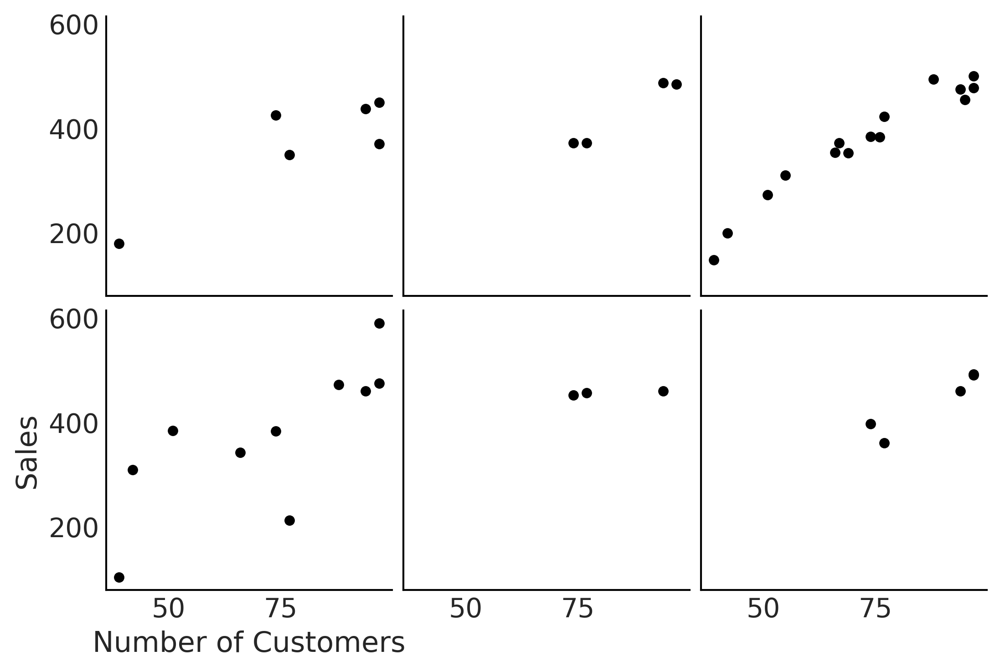

In [70]:
fig, axes, = plt.subplots(2,3, sharex=True, sharey=True)

for i, ax in enumerate(axes.ravel()):
    location_filter = (hierarchical_salad_df["location"] == i)
    hierarchical_salad_df[location_filter].plot(kind="scatter", x="customers", y="sales", ax=ax)
    ax.set_xlabel("")
    ax.set_ylabel("")

    
axes[1,0].set_xlabel("Number of Customers")
axes[1,0].set_ylabel("Sales");
plt.savefig("img/chp04/multiple_salad_sales_scatter.png")

```{code-block} python
:name: model_hierarchical_salad_sales
:caption: model_hierarchical_salad_sales


def gen_hierarchical_salad_sales(input_df, beta_prior_fn, dtype=tf.float32):
    customers = tf.constant(input_df["customers"].values, dtype=dtype)
    location_category = input_df["location"].values
    sales = tf.constant(input_df["sales"].values, dtype=dtype)

    @tfd.JointDistributionCoroutine
    def model_hierarchical_salad_sales():
        β_μ_hyperprior = yield root(tfd.Normal(0, 10, name="beta_mu"))
        β_σ_hyperprior = yield root(tfd.HalfNormal(.1, name="beta_sigma"))
        β = yield from beta_prior_fn(β_μ_hyperprior, β_σ_hyperprior)

        σ_hyperprior = yield root(tfd.HalfNormal(30, name="sigma_prior"))
        σ = yield tfd.Sample(tfd.HalfNormal(σ_hyperprior), 6, name="sigma")

        loc = tf.gather(β, location_category, axis=-1) * customers
        scale = tf.gather(σ, location_category, axis=-1)
        sales = yield tfd.Independent(tfd.Normal(loc, scale),
                                      reinterpreted_batch_ndims=1,
                                      name="sales")

    return model_hierarchical_salad_sales, sales
```

In [71]:
import tensorflow as tf
import tensorflow_probability as tfp

tfd = tfp.distributions
root = tfd.JointDistributionCoroutine.Root

2025-01-24 23:35:15.321155: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-01-24 23:35:15.321185: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-01-24 23:35:15.321844: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-01-24 23:35:15.326143: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [72]:
run_mcmc = tf.function(
    tfp.experimental.mcmc.windowed_adaptive_nuts,
    autograph=False, jit_compile=True)

In [73]:
def gen_hierarchical_salad_sales(input_df, beta_prior_fn, dtype=tf.float32):
    customers = tf.constant(
        hierarchical_salad_df["customers"].values, dtype=dtype)
    location_category = hierarchical_salad_df["location"].values
    sales = tf.constant(hierarchical_salad_df["sales"].values, dtype=dtype)

    @tfd.JointDistributionCoroutine
    def model_hierarchical_salad_sales():
        β_μ_hyperprior = yield root(tfd.Normal(0, 10, name="beta_mu"))
        β_σ_hyperprior = yield root(tfd.HalfNormal(.1, name="beta_sigma"))
        β = yield from beta_prior_fn(β_μ_hyperprior, β_σ_hyperprior)

        σ_hyperprior = yield root(tfd.HalfNormal(30, name="sigma_prior"))
        σ = yield tfd.Sample(tfd.HalfNormal(σ_hyperprior), 6, name="sigma")

        loc = tf.gather(β, location_category, axis=-1) * customers
        scale = tf.gather(σ, location_category, axis=-1)
        sales = yield tfd.Independent(tfd.Normal(loc, scale),
                                      reinterpreted_batch_ndims=1,
                                      name="sales")

    return model_hierarchical_salad_sales, sales

Similar to the TFP models we used in Chapter [3](chap2), the
model is wrapped within a function so we can condition on an arbitrary
inputs more easily. Besides the input data,
`gen_hierarchical_salad_sales` also takes a callable `beta_prior_fn`
which defines the prior of slope $\beta_m$. Inside the Coroutine model
we use a `yield from` statement to invoke the `beta_prior_fn`. This
description may be too abstract in words but is easier to see action in
Code Block
[model_hierarchical_salad_sales_centered](model_hierarchical_salad_sales_centered):

```{code-block} python
:name: model_hierarchical_salad_sales_centered
:caption: model_hierarchical_salad_sales_centered

def centered_beta_prior_fn(hyper_mu, hyper_sigma):
    β = yield tfd.Sample(tfd.Normal(hyper_mu, hyper_sigma), 6, name="beta")
    return β

# hierarchical_salad_df is the generated dataset as pandas.DataFrame
centered_model, observed = gen_hierarchical_salad_sales(
    hierarchical_salad_df, centered_beta_prior_fn)
```

As shown above, Code Block
[model_hierarchical_salad_sales_centered](model_hierarchical_salad_sales_centered)
defined a centered parameterization of the slope $\beta_m$, which
follows a Normal distribution with `hyper_mu` and `hyper_sigma`.
`centered_beta_prior_fn` is a function that yields a `tfp.distribution`,
similar to the way we write a `tfd.JointDistributionCoroutine` model.
Now that we have our model, we can run inference and inspect the result
in Code Block
[model_hierarchical_salad_sales_centered_inference](model_hierarchical_salad_sales_centered_inference).


```{code-block} python
:name: model_hierarchical_salad_sales_centered_inference
:caption: model_hierarchical_salad_sales_centered_inference

mcmc_samples_centered, sampler_stats_centered = run_mcmc(
    1000, centered_model, n_chains=4, num_adaptation_steps=1000,
    sales=observed)

divergent_per_chain = np.sum(sampler_stats_centered["diverging"], axis=0)
print(f"""There were {divergent_per_chain} divergences after tuning per chain.""")
```

```none
There were [37 31 17 37] divergences after tuning per chain.
```

In [74]:
def centered_beta_prior_fn(hyper_mu, hyper_sigma):
    β = yield tfd.Sample(tfd.Normal(hyper_mu, hyper_sigma), 6, name="beta")
    return β

# hierarchical_salad_df is the generated dataset as pandas.DataFrame
centered_model, observed = gen_hierarchical_salad_sales(
    hierarchical_salad_df, centered_beta_prior_fn)

mcmc_samples_centered, sampler_stats_centered = run_mcmc(
    1000, centered_model, n_chains=4, num_adaptation_steps=1000,
    sales=observed)

divergent_per_chain = np.sum(sampler_stats_centered['diverging'], axis=0)
print(f"""There were {divergent_per_chain} divergences after tuning per chain.""")

2025-01-24 23:35:17.506498: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-01-24 23:35:17.544449: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-01-24 23:35:17.546788: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

There were [39 44 55 32] divergences after tuning per chain.


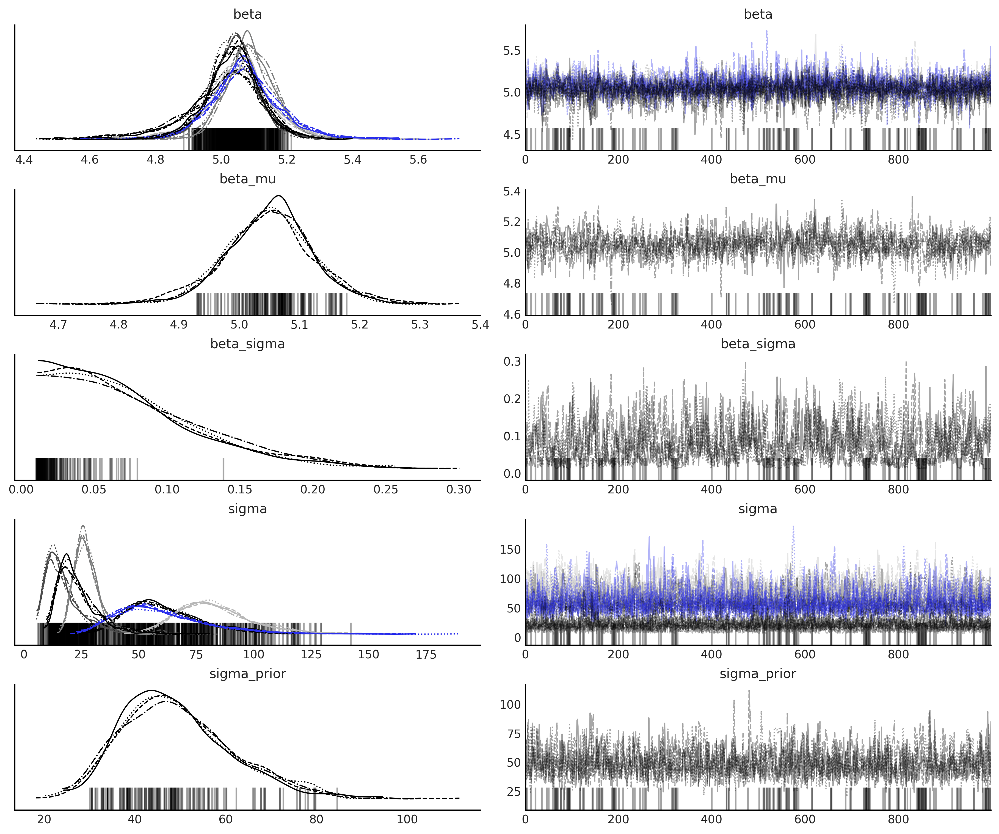

In [75]:
idata_centered_model = az.from_dict(
    posterior={
        k:np.swapaxes(v, 1, 0)
        for k, v in mcmc_samples_centered._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats_centered[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

az.plot_trace(idata_centered_model, compact=True);

In [76]:
az.summary(idata_centered_model)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
beta[0],5.007,0.122,4.758,5.216,0.003,0.002,1319.0,1578.0,1.0
beta[1],5.038,0.074,4.896,5.175,0.002,0.001,1491.0,1861.0,1.0
beta[2],5.087,0.075,4.945,5.225,0.002,0.001,1306.0,1681.0,1.0
beta[3],5.056,0.108,4.852,5.268,0.003,0.002,1426.0,2044.0,1.0
beta[4],5.075,0.111,4.882,5.296,0.003,0.002,1403.0,1825.0,1.0
beta[5],5.035,0.081,4.891,5.201,0.002,0.002,1394.0,1869.0,1.0
beta_mu,5.049,0.074,4.919,5.201,0.002,0.002,1090.0,1609.0,1.0
beta_sigma,0.077,0.050,0.011,0.171,0.002,0.002,399.0,430.0,1.0
sigma[0],61.324,16.925,33.819,94.600,0.546,0.412,1251.0,697.0,1.0
sigma[1],17.764,9.363,6.055,34.094,0.338,0.261,1269.0,852.0,1.0


We reuse the inference code previously shown in Code Block
[tfp_posterior_inference](tfp_posterior_inference) to run
our model. After running our model the first indication of issues is the
divergences, the details of which we covered in Section
{ref}`divergences`. A plot of the sample space is the next
diagnostic and is shown in {numref}`fig:Neals_Funnel_Salad_Centered`.
Note how as the hyperprior $\beta_{\sigma h}$ approaches zero, the width
of the posterior estimate of the $\beta_m$ parameters tend to shrink. In
particular note how there are no samples near zero. In other words as
the value $\beta_{\sigma h}$ approaches zero, there the region in which
to sample parameter $\beta_m$ collapses and the sampler is not able to
effectively characterize this space of the posterior.

```{figure} figures/Neals_Funnel_Salad_Centered.png
:name: fig:Neals_Funnel_Salad_Centered
:width: 7.00in
Scatter plot of the hyperprior and the slope of $\beta[4]$ from
`centered_model` defined in Code Block
[model_hierarchical_salad_sales_centered](model_hierarchical_salad_sales_centered).
As the hyperprior approaches zero the posterior space for slope
collapses results in the divergences seen in blue.
```

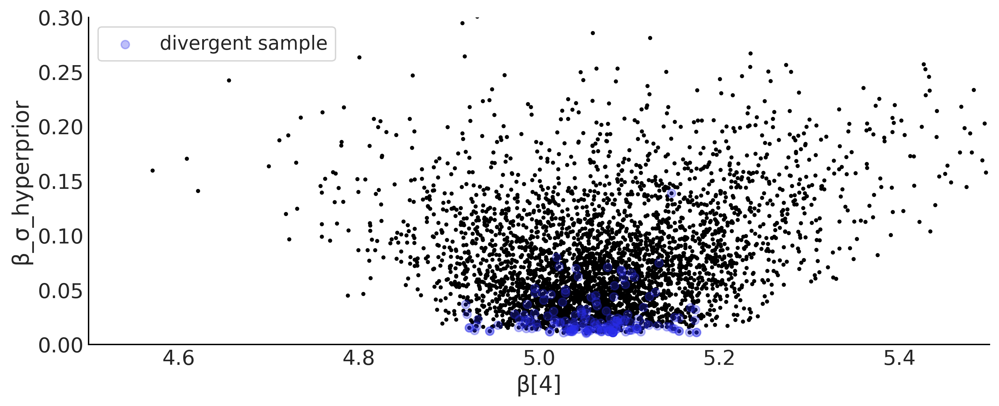

In [77]:
slope = mcmc_samples_centered.beta[..., 4].numpy().flatten()
sigma = mcmc_samples_centered.beta_sigma.numpy().flatten()
divergences = sampler_stats_centered['diverging'].numpy().flatten()

axes = az.plot_pair({"β[4]": slope, "β_σ_hyperprior": sigma}, figsize=(10, 4))

axes.scatter(slope[divergences], sigma[divergences], c="C4", alpha=.3, label='divergent sample')
axes.legend(frameon=True)
axes.set_ylim(0, .3)
axes.set_xlim(4.5, 5.5)

plt.savefig("img/chp04/Neals_Funnel_Salad_Centered.png")

To alleviate this issue the centered parameterization can be converted
into a non-centered parameterization shown in Code Block in
[model_hierarchical_salad_sales_non_centered](model_hierarchical_salad_sales_non_centered)
and Equation {eq}`eq:noncentered_hierarchical_regression`. The key
difference is that instead of estimating parameters of the slope
$\beta_m$ directly, it is instead modeled as a common term shared
between all groups and a term for each group that captures the deviation
from the common term. This modifies the posterior geometry in a manner
that allows the sampler to more easily explore all possible values of
$\beta_{\sigma h}$. The effect of this posterior geometry change is as
shown in {numref}`fig:Neals_Funnel_Salad_NonCentered`, where there are
multiple samples down to the 0 value on the x-axis.

```{math} 
:label: eq:noncentered_hierarchical_regression
\begin{split}
\beta_{\mu h} \sim& \mathcal{N} \\
\beta_{\sigma h} \sim& \mathcal{HN} \\
\beta_\text{m\_offset} \sim& \mathcal{N}(0,1) \\
\beta_m =& \overbrace{\beta_{\mu h} + \beta_\text{m\_offset}*\beta_{\sigma h}}^{\text{Non-centered}}  \\
\sigma_{h} \sim& \mathcal{HN} \\
\sigma_{m} \sim& \mathcal{HN}(\sigma_{h}) \\
Y \sim& \mathcal{N}(\beta_{m} * X_m,\sigma_{m})
\end{split}

```

```{code-block} python
:name: model_hierarchical_salad_sales_non_centered
:caption: model_hierarchical_salad_sales_non_centered

def non_centered_beta_prior_fn(hyper_mu, hyper_sigma):
    β_offset = yield root(tfd.Sample(tfd.Normal(0, 1), 6, name="beta_offset"))
    return β_offset * hyper_sigma[..., None] + hyper_mu[..., None]

# hierarchical_salad_df is the generated dataset as pandas.DataFrame
non_centered_model, observed = gen_hierarchical_salad_sales(
    hierarchical_salad_df, non_centered_beta_prior_fn)

mcmc_samples_noncentered, sampler_stats_noncentered = run_mcmc(
    1000, non_centered_model, n_chains=4, num_adaptation_steps=1000,
    sales=observed)

divergent_per_chain = np.sum(sampler_stats_noncentered["diverging"], axis=0)
print(f"There were {divergent_per_chain} divergences after tuning per chain.")
```

```none
There were [1 0 2 0] divergences after tuning per chain.
```


```{figure} figures/Neals_Funnel_Salad_NonCentered.png
:name: fig:Neals_Funnel_Salad_NonCentered
:width: 7.00in
Scatter plot of the hyperprior and the estimated slope $\beta[4]$ of
location 4 from `non_centered_model` defined in Code Block
[model_hierarchical_salad_sales_non_centered](model_hierarchical_salad_sales_non_centered).
In the non-centered parameterization the sampler is able to sample
parameters close to zero. The divergences are lesser in number and are
not concentrated in one area.
```

In [78]:
def non_centered_beta_prior_fn(hyper_mu, hyper_sigma):
    β_offset = yield root(tfd.Sample(tfd.Normal(0, 1), 6, name="beta_offset"))
    return β_offset * hyper_sigma[..., None] + hyper_mu[..., None]

# hierarchical_salad_df is the generated dataset as pandas.DataFrame
non_centered_model, observed = gen_hierarchical_salad_sales(
    hierarchical_salad_df, non_centered_beta_prior_fn)

mcmc_samples_noncentered, sampler_stats_noncentered = run_mcmc(
    1000, non_centered_model, n_chains=4, num_adaptation_steps=1000,
    sales=observed)

divergent_per_chain = np.sum(sampler_stats_noncentered['diverging'], axis=0)
print(f"""There were {divergent_per_chain} divergences after tuning per chain.""")

2025-01-24 23:37:26.476812: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator mcmc_retry_init/assert_equal_1/Assert/AssertGuard/Assert


There were [2 0 1 0] divergences after tuning per chain.


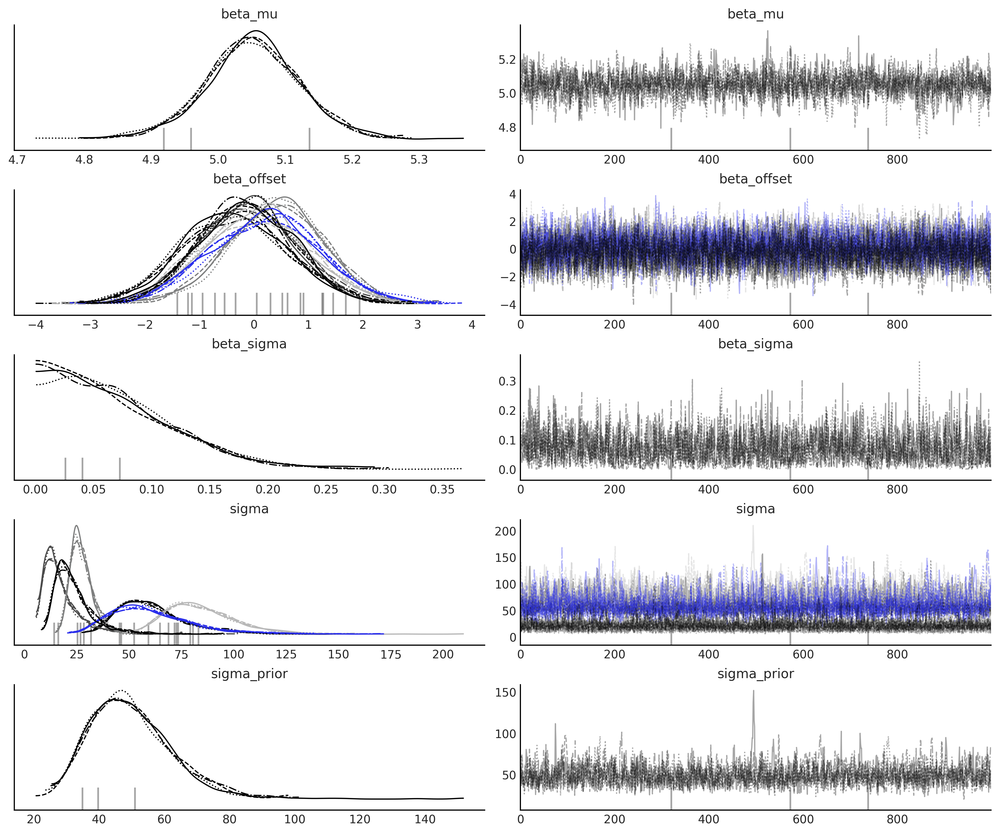

In [79]:
idata_non_centered_model = az.from_dict(
    posterior={
        k:np.swapaxes(v, 1, 0)
        for k, v in mcmc_samples_noncentered._asdict().items()},
    sample_stats={
        k:np.swapaxes(sampler_stats_noncentered[k], 1, 0)
        for k in ["target_log_prob", "diverging", "accept_ratio", "n_steps"]}
)

az.plot_trace(idata_non_centered_model, compact=True);

In [80]:
az.summary(idata_non_centered_model)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
beta_mu,5.050,0.072,4.917,5.190,0.002,0.001,1862.0,1782.0,1.0
beta_offset[0],-0.363,0.987,-2.088,1.613,0.018,0.015,3026.0,2743.0,1.0
beta_offset[1],-0.098,0.884,-1.715,1.561,0.018,0.013,2514.0,2670.0,1.0
beta_offset[2],0.415,0.879,-1.191,2.142,0.017,0.013,2626.0,3109.0,1.0
beta_offset[3],0.034,0.994,-1.837,1.859,0.017,0.018,3452.0,2721.0,1.0
beta_offset[4],0.220,1.019,-1.750,2.086,0.019,0.016,2980.0,2653.0,1.0
beta_offset[5],-0.153,0.866,-1.769,1.471,0.017,0.013,2729.0,2565.0,1.0
beta_sigma,0.070,0.052,0.000,0.161,0.001,0.001,1355.0,1315.0,1.0
sigma[0],60.831,16.597,34.669,93.292,0.376,0.283,2454.0,1927.0,1.0
sigma[1],18.005,10.253,6.093,35.468,0.427,0.317,1007.0,680.0,1.0


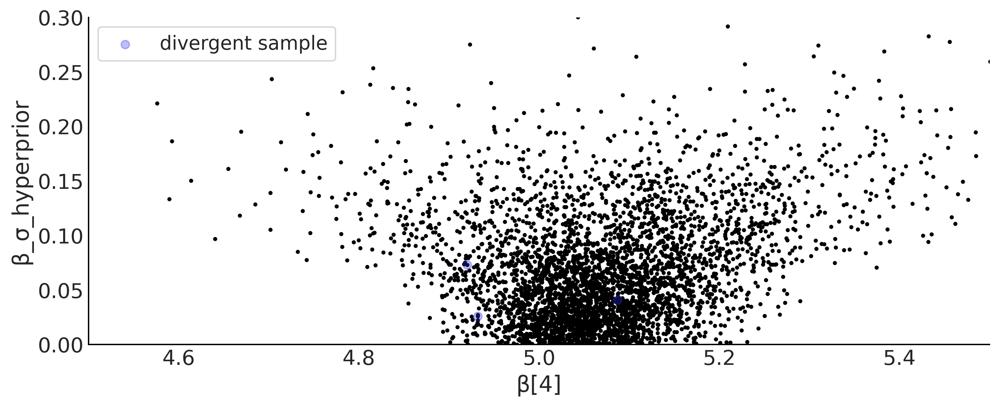

In [81]:
noncentered_beta = (mcmc_samples_noncentered.beta_mu[..., None]
        + mcmc_samples_noncentered.beta_offset * mcmc_samples_noncentered.beta_sigma[..., None])
slope = noncentered_beta[..., 4].numpy().flatten()
sigma = mcmc_samples_noncentered.beta_sigma.numpy().flatten()
divergences = sampler_stats_noncentered['diverging'].numpy().flatten()

axes = az.plot_pair({"β[4]": slope, "β_σ_hyperprior": sigma}, figsize=(10, 4))
axes.scatter(slope[divergences], sigma[divergences], c="C4", alpha=.3, label='divergent sample')
axes.legend(frameon=True)
axes.set_ylim(0, .3)
axes.set_xlim(4.5, 5.5)

plt.savefig("img/chp04/Neals_Funnel_Salad_NonCentered.png")

The improvement in sampling has a material effect on the estimated
distribution shown in {numref}`fig:Salad_Sales_Hierarchical_Comparison`.
While it may be jarring to be reminded of this fact again, samplers
merely estimate the posterior distribution, and while in many cases they
do quite well, it is not guaranteed! Be sure to pay heed to the
diagnostics and investigate more deeply if warnings arise.

It is worth noting that there is no one size fits all solution when it
comes to centered or non-centered parameterization
{cite:p}`Papaspiliopoulos2007`. It is a complex interaction among the
informativeness of the individual likelihood at group level (usually the
more data you have for a specific group, the more informative the
likelihood function will be), the informativeness of the group level
prior, and the parameterization. A general heuristic is that if there
are not a lot of observations, a non-centered parameterization is
preferred. In practice however, you should try a few different
combinations of centered and non-centered parameterizations, with
different prior specifications. You might even find cases where you need
*both* centered and non-centered parameterization in a single model. We
recommend you to read Michael Betancourt's case study Hierarchical
Modeling on this topic if you suspect model parameterization is causing
you sampling issues {cite:p}`betancourt_2020_hierarchical`.

```{figure} figures/Salad_Sales_Hierarchical_Comparison.png
:name: fig:Salad_Sales_Hierarchical_Comparison
:width: 7.00in
KDE of the distributions of $\beta_{\sigma h}$ in both centered and
non-centered parameterizations. The change is due to the sampler being
able to more adequately explore the possible parameter space.
```

In [82]:
centered_β_sigma = mcmc_samples_centered.beta_sigma.numpy()
noncentered_β_sigma = mcmc_samples_noncentered.beta_sigma.numpy()

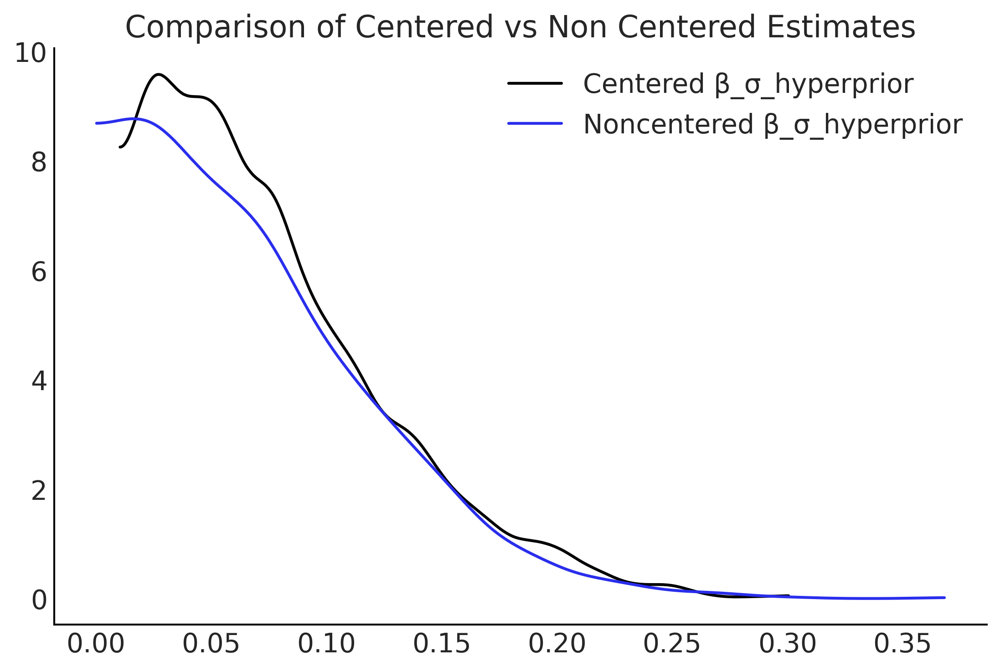

In [83]:
fig, ax = plt.subplots()
az.plot_kde(centered_β_sigma, label="Centered β_σ_hyperprior", ax=ax)
az.plot_kde(noncentered_β_sigma, label="Noncentered β_σ_hyperprior", plot_kwargs={"color":"C4"}, ax=ax);

ax.set_title("Comparison of Centered vs Non Centered Estimates");
plt.savefig("img/chp04/Salad_Sales_Hierarchical_Comparison.png")

(predictions-at-multiple-levels)=

### 4.6.2 Predictions at Multiple Levels

A subtle feature of hierarchical models is that they are able to make
estimates at multiple levels. While seemingly obvious this is very
useful, as it lets us use one model to answer many more questions than a
single level model. In Chapter [3](chap2) we could built a model
to estimate the mass of a single species or a separate model to estimate
the mass of any penguin regardless of species. Using a hierarchical
model we could estimate the mass of all penguins, and each penguin
species, at the same time with one model. With our salad sales model we
can both make estimations about an individual location and about the
population a whole. We can do so by using our previous
`non_centered_model` from Code Block
[model_hierarchical_salad_sales_non_centered](model_hierarchical_salad_sales_non_centered),
and write an `out_of_sample_prediction_model` as shown in Code Block
[model_hierarchical_salad_sales_predictions](model_hierarchical_salad_sales_predictions).
This using the fitted parameter estimates to make an out of sample
prediction for the distribution of customers for 50 customers, at two
locations and for the company as a whole *simultaneously*. Since our
`non_centered_model` is also a TFP distribution, we can nest it into
another `tfd.JointDistribution`, doing so constructed a larger Bayesian
graphical model that extends our initial `non_centered_model` to include
nodes for out of sample prediction. The estimates are plotted in
{numref}`fig:Salad_Sales_Hierarchical_Predictions`.

```{code-block} python
:name: model_hierarchical_salad_sales_predictions
:caption: model_hierarchical_salad_sales_predictions

out_of_sample_customers = 50.

@tfd.JointDistributionCoroutine
def out_of_sample_prediction_model():
    model = yield root(non_centered_model)
    β = model.beta_offset * model.beta_sigma[..., None] + model.beta_mu[..., None]
    
    β_group = yield tfd.Normal(
        model.beta_mu, model.beta_sigma, name="group_beta_prediction")
    group_level_prediction = yield tfd.Normal(
        β_group * out_of_sample_customers,
        model.sigma_prior,
        name="group_level_prediction")
    for l in [2, 4]:
        yield tfd.Normal(
            tf.gather(β, l, axis=-1) * out_of_sample_customers,
            tf.gather(model.sigma, l, axis=-1),
            name=f"location_{l}_prediction")

amended_posterior = tf.nest.pack_sequence_as(
    non_centered_model.sample(),
    list(mcmc_samples_noncentered) + [observed])

ppc = out_of_sample_prediction_model.sample(var0=amended_posterior)
```

```{figure} figures/Salad_Sales_Hierarchical_Predictions.png
:name: fig:Salad_Sales_Hierarchical_Predictions
:width: 7.00in
Posterior predictive estimates for the revenues for two of the groups
and for total population estimated by model
`model_hierarchical_salad_sales_non_centered`.
```

In [84]:
out_of_sample_customers = 50.

@tfd.JointDistributionCoroutine
def out_of_sample_prediction_model():
    model = yield root(non_centered_model)
    β = model.beta_offset * model.beta_sigma[..., None] + model.beta_mu[..., None]
    
    β_group = yield tfd.Normal(
        model.beta_mu, model.beta_sigma, name="group_beta_prediction")
    group_level_prediction = yield tfd.Normal(
        β_group * out_of_sample_customers,
        model.sigma_prior,
        name="group_level_prediction")
    for l in [2, 4]:
        yield tfd.Normal(
            tf.gather(β, l, axis=-1) * out_of_sample_customers,
            tf.gather(model.sigma, l, axis=-1),
            name=f"location_{l}_prediction")

amended_posterior = tf.nest.pack_sequence_as(
    non_centered_model.sample(),
    list(mcmc_samples_noncentered) + [observed],
)
ppc = out_of_sample_prediction_model.sample(var0=amended_posterior)

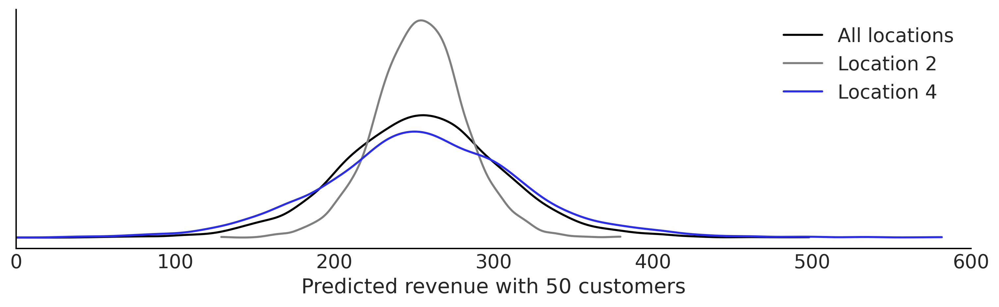

In [85]:
fig, ax = plt.subplots(figsize=(10, 3))

az.plot_kde(ppc.group_level_prediction.numpy(), plot_kwargs={"color":"C0"}, ax=ax, label="All locations")
az.plot_kde(ppc.location_2_prediction.numpy(), plot_kwargs={"color":"C2"}, ax=ax, label="Location 2")
az.plot_kde(ppc.location_4_prediction.numpy(), plot_kwargs={"color":"C4"}, ax=ax, label="Location 4")

ax.set_xlabel("Predicted revenue with 50 customers")
ax.set_xlim([0,600])

ax.set_yticks([])

plt.savefig("img/chp04/Salad_Sales_Hierarchical_Predictions.png")

Another feature in making predictions is using hierarchical models with
hyperpriors is that we can make prediction for never before seen groups.
In this case, imagine we are opening another salad restaurant in a new
location we can already make some predictions of how the salad sales
might looks like by first sampling from the hyper prior to get the
$\beta_{i+1}$ and $\sigma_{i+1}$ of the new location, then sample from
the posterior predictive distribution to get salad sales prediction.
This is demonstrated in Code Block
[model_hierarchical_salad_sales_predictions_new_location](model_hierarchical_salad_sales_predictions_new_location).

```{code-block} python
:name: model_hierarchical_salad_sales_predictions_new_location
:caption: model_hierarchical_salad_sales_predictions_new_location

out_of_sample_customers2 = np.arange(50, 90)

@tfd.JointDistributionCoroutine
def out_of_sample_prediction_model2():
    model = yield root(non_centered_model)
    
    β_new_loc = yield tfd.Normal(
        model.beta_mu, model.beta_sigma, name="beta_new_loc")
    σ_new_loc = yield tfd.HalfNormal(model.sigma_prior, name="sigma_new_loc")
    group_level_prediction = yield tfd.Normal(
        β_new_loc[..., None] * out_of_sample_customers2,
        σ_new_loc[..., None],
        name="new_location_prediction")

ppc = out_of_sample_prediction_model2.sample(var0=amended_posterior)
```

In [86]:
out_of_sample_customers2 = np.arange(50, 90)

@tfd.JointDistributionCoroutine
def out_of_sample_prediction_model2():
    model = yield root(non_centered_model)
    
    β_new_loc = yield tfd.Normal(
        model.beta_mu, model.beta_sigma, name="beta_new_loc")
    σ_new_loc = yield tfd.HalfNormal(model.sigma_prior, name="sigma_new_loc")
    group_level_prediction = yield tfd.Normal(
        β_new_loc[..., None] * out_of_sample_customers2,
        σ_new_loc[..., None],
        name="new_location_prediction")

ppc = out_of_sample_prediction_model2.sample(var0=amended_posterior)

/home/hwting/anaconda3/envs/rapids/lib/python3.11/site-packages/arviz/data/base.py:272: UserWarning: More chains (1000) than draws (4). Passed array should have shape (chains, draws, *shape)
  warnings.warn(


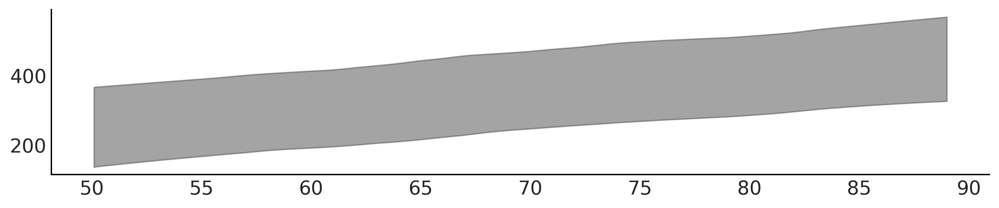

In [87]:
az.plot_hdi(out_of_sample_customers2, ppc.new_location_prediction, hdi_prob=.95, figsize=(10, 2));

In addition to the mathematical benefits of hierarchical modeling, there
is a benefit from a computational perspective as we only need to
construct and fit a single model. This speeds up the modeling process
and the subsequent model maintenance process, if the model is reused
multiple times over time.

::: {admonition} On the validity of LOO

Hierarchical models allow us to make posterior
predictions even for group(s) that have never been seen before. However,
how valid would the prediction be? Could we use cross-validation to
assess the performance of the model? As usually in statistics the answer
is *that depends*. Whether cross-validation (and methods like LOO and
WAIC) is valid or not depends on the prediction task you want to
perform, and also on the data generating mechanism. If we want to use
LOO to assess how well the model is able to predict new observations ,
then LOO is fine. Now if we want to assess how well one entire group is
predicted, then you will need to perform leave one-group-out cross
validation, which is a well defined procedure. In that case however, the
LOO method will most likely not be good, as we are removing many
observations at a time and the importance sampling step at the core of
the LOO approximation relies on the distributions with and without the
point/group/etc being close to each other.
:::


(priors-for-multilevel-models)=

### 4.6.3 Priors for Multilevel Models

Prior choice is all the more important for multilevel models, because of
how the prior interacts with the informativeness of the likelihood, as
shown above in Section {ref}`model_geometry`. Moreover, not only does the
shape of prior distribution matter, we also have additional choices of
how to parameterize them. This does not limit us to Gaussian priors as
it applies to all distributions in the location-scale distribution
family [^6].

In multilevel models prior distributions not only characterize the
in-group variation, but the between-group variation as well. In a sense
the choice of hyperprior is defining the "variation of variation\",
which could make expressing and reasoning about prior information
difficult. Moreover, since the effect of partial pooling is the
combination of how informative the hyperprior is, the number of groups
you have, and the number of observations in each group. Due to this the
same hyperprior might not work if you are performing inference using the
same model on similar dataset but with fewer groups.

As is such besides empirical experience (e.g., general recommendations
published in articles) or general advice [^7], we can also perform
sensitivity studies to better inform our prior choice. For instance
Lemoine {cite:p}`lemoine_2019` showed that when modeling ecology data with a
model structure of

```{math} 
:label: eq:ecology_regression
\begin{split}
    \alpha_i \sim& \mathcal{N}(\mu_{\alpha},\sigma^2_{\alpha}) \\
    \mu_{i} =& \alpha_i + \beta Day_i \\
    Y \sim& \mathcal{N}(\mu_{j},\sigma^2)
\end{split}

```

where the intercept is unpooled, Cauchy priors provide regularization at
few data points, and do not obscure the posterior when the model is
fitted on additional data. This is done through prior sensitivity
analysis across both prior parameterizations and differing amounts of
data. In your own multilevel models be sure to note multitude of ways a
prior choice affects inference, and use either your domain expertise or
tools such as prior predictive distributions to make an informed choice.

[^6]: [https://en.wikipedia.org/wiki/Location--scale_family](https://en.wikipedia.org/wiki/Location–scale_family)

[^7]: <https://github.com/stan-dev/stan/wiki/Prior-Choice-Recommendations>

(exercises4)=

## 4.7 Exercises

**4E1.** What are examples of covariate-response
relationships that are nonlinear in everyday life?

**4E2.** Assume you are studying the relationship between a
covariate and an outcome and the data can be into 2 groups. You will be
using a regression with a slope and intercept as your basic model
structure.
```{math} 
\begin{split}
    \mu =& \beta_0 + \beta_1 X_1 \\
    Y \sim& \mathcal{N}(\mu, \sigma)
\end{split}
```

Also assume you now need to extend the model structure in each of the
ways listed below. For each item write the mathematical equations that
specify the full model.

1.  Pooled

2.  Unpooled

3.  Mixed Effect with pooled $\beta_0$

4.  Hierarchical $\beta_0$

5.  Hierarchical all parameters

6.  Hierarchical all parameters with non-centered $\beta$ parameters

**4E3.** Use statistical notation to write a robust linear
regression model for the baby dataset.

**4E4.** Consider the plight of a bodybuilder who needs to
lift weights, do cardiovascular exercise, and eat to build a physique
that earns a high score at a contest. If we were to build a model where
weightlifting, cardiovascular exercise, and eating were covariates do
you think these covariates are independent or do they interact? From
your domain knowledge justify your answer?

**4E5.** An interesting property of the Student's
t-distribution is that at values of $\nu = 1$ and $\nu = \infty$, the
Student's t-distribution becomes identical two other distributions the
Cauchy distribution and the Normal distribution. Plot the Student's
t-distribution at both parameter values of $\nu$ and match each
parameterization to Cauchy or Normal.

**4E6.** Assume we are trying to predict the heights of
individuals. If given a dataset of height and one of the following
covariates explain which type of regression would be appropriate between
unpooled, pooled, partially pooled, and interaction. Explain why

1.  A vector of random noise

2.  Gender

3.  Familial relationship

4.  Weight

**4E7.** Use LOO to compare the results of
`baby_model_linear` and `baby_model_sqrt`. Using LOO justify why the
transformed covariate is justified as a modeling choice.

**4E8.** Go back to the penguin dataset. Add an interaction
term to estimate penguin mass between species and flipper length. How do
the predictions differ? Is this model better? Justify your reasoning in
words and using LOO.

**4M9.** Ancombe's Quartet is a famous dataset highlighting
the challenges with evaluating regressions solely on numerical
summaries. The dataset is available at the GitHub repository. Perform a
regression on the third case of Anscombe's quartet with both robust and
non-robust regression. Plot the results.

**4M10.** Revisit the penguin mass model defined in Code Block
[nocovariate_mass](nocovariate_mass). Add a hierarchical
term for $\mu$. What is the estimated mean of the hyperprior? What is
the average mass for all penguins? Compare the empirical mean to the
estimated mean of the hyperprior. Do the values of the two estimates
make sense to you, particularly when compared to each other? Why?

**4M11.** The compressive strength of concrete is dependent
on the amount of water and cement used to produce it. In the GitHub
repository we have provided a dataset of concrete compressive strength,
as well the amount of water and cement included (kilograms per cubic
meter). Create a linear model with an interaction term between water and
cement. What is different about the inputs of this interaction model
versus the smoker model we saw earlier? Plot the concrete compressive
strength as function of concrete at various fixed values of water.

**4M12.** Rerun the pizza regression but this time do it with
heteroskedastic regression. What are the results?

**4H13.** Radon is a radioactive gas that can cause lung
cancer and thus it is something that would be undesirable in a domicile.
Unfortunately the presence of a basement may increase the radon levels
in a household as radon may enter the household more easily through the
ground. We have provided a dataset of the radon levels at homes in
Minnesota, in the GitHub repository as well as the county of the home,
and the presence of a basement.

1.  Run an unpooled regression estimating the effect of basements on
    radon levels.

2.  Create a hierarchical model grouping by county. Justify why this
    model would be useful for the given the data.

3.  Create a non-centered regression. Using plots and diagnostics
    justify if the non-centered parameterization was needed.


**4H14.** Generate a synthetic dataset for each of the models
below with your own choice of parameters. Then fit two models to each
dataset, one model matching the data generating process, and one that
does not. See how the diagnostic summaries and plots differ between the
two.

For example, we may generate data that follows a linear pattern
$x=[1,2,3,4], y=[2,4,6,8]$. Then fit a model of the form $y=bx$ and
another of the form $y=bx**2$

1.  Linear Model

2.  Linear model with transformed covariate

3.  Linear model with interaction effect

4.  4 group model with pooled intercept, and unpooled slope and noise

5.  A Hierarchical Model


**4H15.** For the hierarchical salad regression model
evaluate the posterior geometry for the slope parameter $\beta_{\mu h}$.
Then create a version of the model where $\beta_{\mu h}$ is
non-centered. Plot the geometry now. Are there any differences? Evaluate
the divergences and output as well. Does non-centering help in this
case?

**4H16.** A colleague of yours, who now lives on an unknown
planet, ran experiment to test the basic laws of physics. She dropped a
ball of a cliff and registers the position for 20 seconds. The data is
available in the Github repository in the file
`gravity_measurements.csv` You know that from Newton's Laws of physics
if the acceleration is $g$ and the time $t$ then

```{math}
:label: eq:physics_experiment
\begin{split}
\text{velocity} &= gt \\
\text{position} &= \frac{1}{2}gt^2 \\
\end{split}
```

Your friend asks you to estimate the following quantities

1.  The gravitational constant of the planet

2.  A characterization of the noise of her measurement device

3.  The velocity of the ball at each point during her measurements

4.  The estimated position of the ball from time 20 to time 30